Implement L1-regularized logistic regression with kernel machine. A a base use Exercise 2 in Sheet 8. More information in Exercise Sheet 9 PDF.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.datasets import make_moons
%matplotlib inline

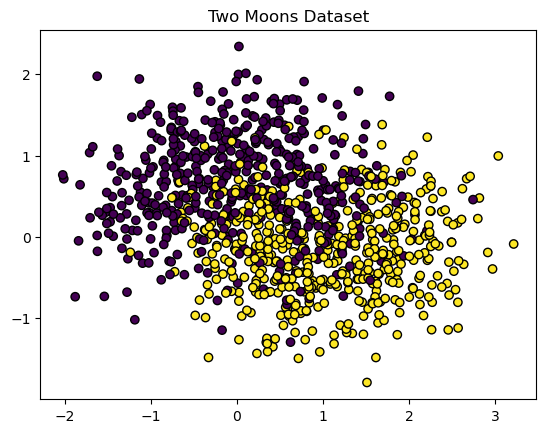

In [4]:
# Generate the two moons dataset
X, y = make_moons(n_samples=1000, noise=0.5, random_state=0)

# Visualize the dataset
plt.scatter(X[:, 0], X[:, 1], c=y, edgecolor='k')
plt.title('Two Moons Dataset')
plt.show()


In [5]:
# As you know we need to split the data into training, validation and test
x_train=X[0:800,:]
y_train=y[0:800].astype(int)

x_val=X[800:900,:]
y_val=y[800:900].astype(int)

x_test=X[900:1000,:]
y_test=y[900:1000].astype(int)

In [8]:
#define utility functions
def linear(x,w):
    assert x.shape[1]==w.shape[0]
    return x@w

def softmax(scores):
    max = np.max(scores, axis=1, keepdims=True)
    exp = np.exp(scores - max)
    sum_exp = np.sum(exp, axis=1, keepdims=True)
    return exp/sum_exp

# Binary cross-entropy loss
def binary_cross_entropy(pred, y):
    epsilon = 1e-15  # To prevent log(0)
    pred = np.clip(pred, epsilon, 1 - epsilon)
    return -np.sum(y * np.log(pred) + (1 - y) * np.log(1 - pred))

# Define the sigmoid function
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

# Define the RBF kernel function
def rbf_kernel(X1, X2, gamma):
    diff = X1[:, np.newaxis, :] - X2[np.newaxis, :, :]
    squared_dist = np.sum(diff ** 2, axis=2)
    return np.exp(-gamma * squared_dist)

def polynomial_kernel(X1, X2, gamma, r, M):
    product = np.dot(X1, X2.T) 
    term = gamma * product + r
    return np.power(term, M)
    

def evaluate_model(X, y, w):

    # Add bias term to test data
    X = np.hstack([X, np.ones((X.shape[0], 1))])
    # Make predictions
    scores = X @ w
    predictions = (1 / (1 + np.exp(-scores))) >= 0.5

    # Calculate accuracy
    accuracy = np.mean(predictions == y)
    print(f"Test Accuracy: {accuracy * 100:.2f}%")
    return accuracy

def draw_decision_boundary(X, y, w, centroids, gamma, kernel=True):
    """
    Draw the decision boundary for logistic regression or kernelized logistic regression.

    """
    # Determine input space for the raw data
    h = 0.02
    x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
    y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5

    # Create a mesh grid for plotting decision boundary
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))

    # Prepare the grid for prediction
    grid = np.c_[xx.ravel(), yy.ravel()]

    
    

    # Apply kernel transformation if a kernel function is provided
    if kernel:
        grid_transformed = rbf_kernel(grid, centroids, gamma)  # Transform grid using the kernel
    else:
        grid_transformed = grid  # Use raw grid

    #add bias term  
    grid_transformed = np.hstack([grid_transformed, np.ones((grid_transformed.shape[0], 1))])

    # Compute the scores using the trained weights
    scores_grid = grid_transformed @ w

    # Apply the sigmoid function to get probabilities
    Z = sigmoid(scores_grid).reshape(xx.shape)

    # Plot the decision boundary
    plt.figure(figsize=(10, 6))

    # Plot the contour where probability is 0.5
    plt.contourf(xx, yy, Z, levels=[0, 0.5, 1], alpha=0.8, cmap=plt.cm.RdBu_r)

    # Plot the original data points
    if X is not None and y is not None:
        plt.scatter(X[:, 0], X[:, 1], c=y, edgecolor='k', s=50)
    elif y is not None:
        plt.scatter(X[:, 0], X[:, 1], c=y, edgecolor='k', s=50)

    plt.title('Logistic Regression Decision Boundary')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()

In [14]:
def logistic_regression_L1_reg_train(x_train, y_train, lamda, nr_iters=100, C=1):

    losses = []

    # Add bias term to the feature matrix
    X = np.hstack([x_train, np.ones((x_train.shape[0], 1))])  # Add bias term as the last column
    n_features = X.shape[1]
    
    # Initialize weights
    w = np.zeros(n_features)

    for i in range(1, nr_iters + 1):
        learning_rate = C / i
        
        # Compute predictions
        scores = X @ w
        pred = sigmoid(scores)
            
        # Compute loss
        loss = binary_cross_entropy(pred, y_train) + lamda * np.sum(np.abs(w[:-1]))
        losses.append(loss)
            
        # Compute gradient
        grad = X.T @ (pred - y_train)
        grad[:-1] += lamda * np.sign(w[:-1]) # L1-regularisierung
            
        # Update weights
        w -= learning_rate * grad

        #print(f"Iteration {i}, Loss: {loss}")

    # Plot the loss over iterations
    plt.plot(range(1, len(losses)+1), losses, marker='o')
    plt.title('Loss over Iterations')
    plt.xlabel('Iteration')
    plt.ylabel('Loss')
    plt.show()

    return w

### TO-DO:
- Apply rbf-kernel, polynomial-kernel
- Apply different learning rates gamma = [0.01, 0.1, 1, 10, 100]
- Archive an accurancy of 80%
- print number of model coefficient equal to zero

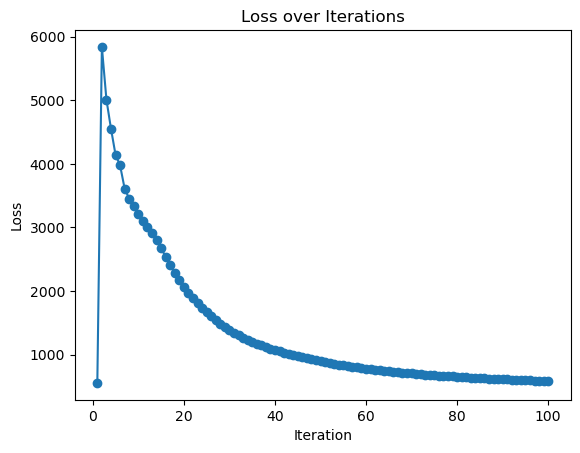

Hyperparameters: gamma for rbf_kernel: 1.0, lambda: 0.001, learning_rate: 1/i, iter: 100
Number of zero coefficients: 0
w_kern: [-24.23947427   0.9888206   -2.57968701 -16.76994192 -21.78227027
   6.28226905  -4.378626     5.74570553   2.74197128  -4.53967783
   0.2781759   11.13855187   1.54205068   1.17795944   6.1075649
  -3.32324204   9.71747919  -3.72043835  -3.23481097  -0.99406179
   1.0800138 ]
Test Accuracy: 80.00%


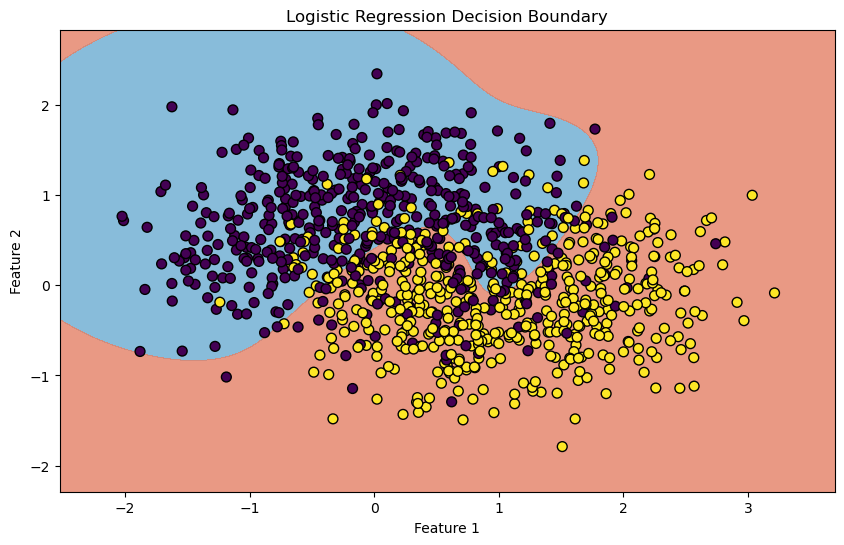

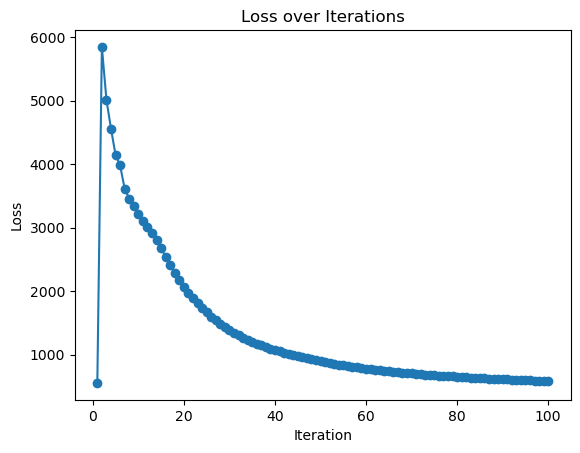

Hyperparameters: gamma for rbf_kernel: 1.0, lambda: 0.01, learning_rate: 1/i, iter: 100
Number of zero coefficients: 0
w_kern: [-24.20484336   1.01266968  -2.57262998 -16.7419429  -21.75177741
   6.25820834  -4.36231876   5.72177278   2.73699054  -4.53763557
   0.29511904  11.1110401    1.56220892   1.17810014   6.09723641
  -3.30207154   9.68131488  -3.69623301  -3.24185558  -1.01970059
   1.07905331]
Test Accuracy: 80.00%


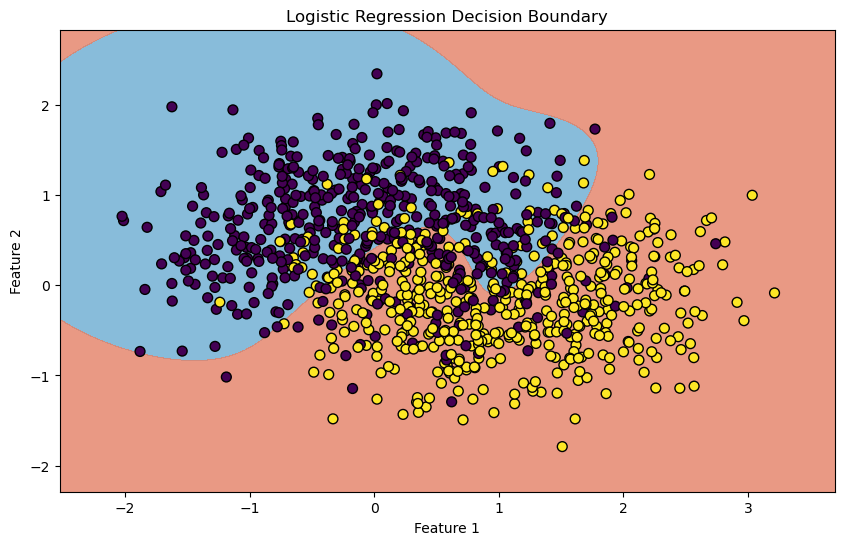

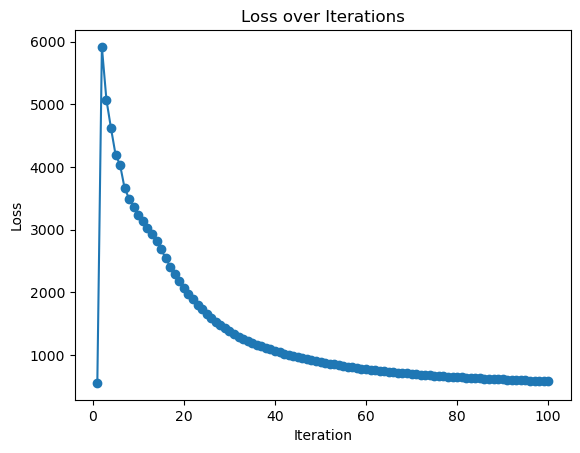

Hyperparameters: gamma for rbf_kernel: 1.0, lambda: 0.1, learning_rate: 1/i, iter: 100
Number of zero coefficients: 0
w_kern: [-23.85898811   1.23956302  -2.50404837 -16.46228544 -21.44733407
   6.0227374   -4.20047126   5.48794041   2.68451727  -4.51240556
   0.45641606  10.83633055   1.75329631   1.1707032    5.99534319
  -3.09193007   9.32105079  -3.4567283   -3.30174086  -1.26051835
   1.0676234 ]
Test Accuracy: 79.00%


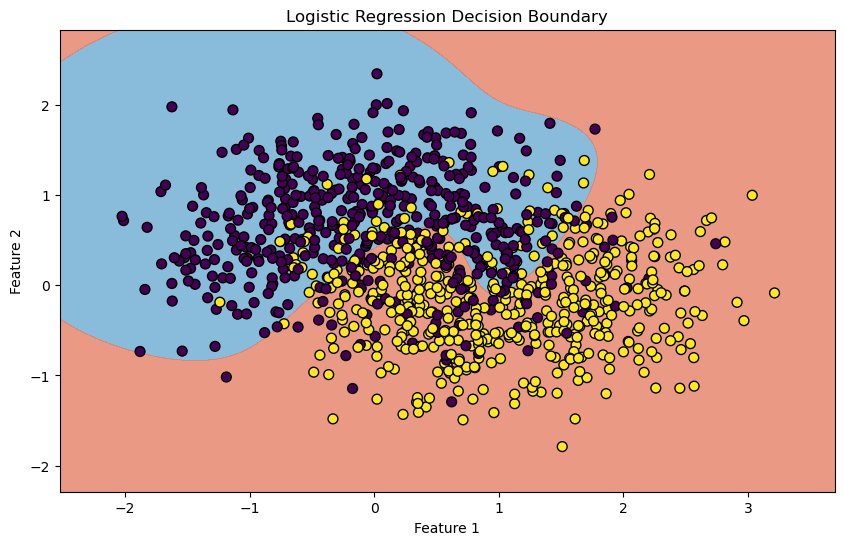

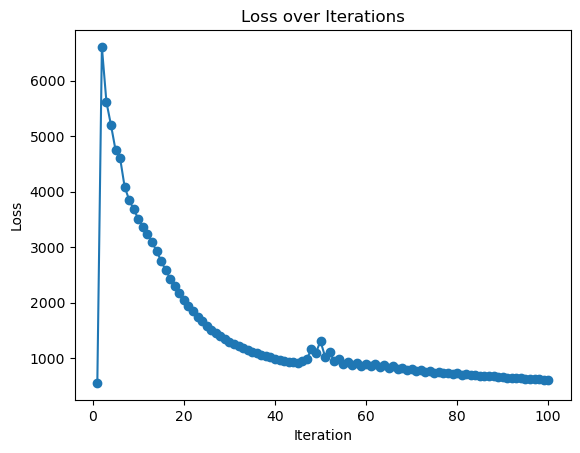

Hyperparameters: gamma for rbf_kernel: 1.0, lambda: 1, learning_rate: 1/i, iter: 100
Number of zero coefficients: 0
w_kern: [-20.60240485   2.2288664   -2.36231662 -13.99674615 -18.69433122
   4.6157325   -2.67571014   4.22360081   1.81733983  -3.66260996
   1.28262782   8.51932135   2.53714273   0.15212327   4.7349866
  -1.5238243    6.34493961  -1.44199817  -3.18698567  -2.40591296
   0.21961884]
Test Accuracy: 81.00%


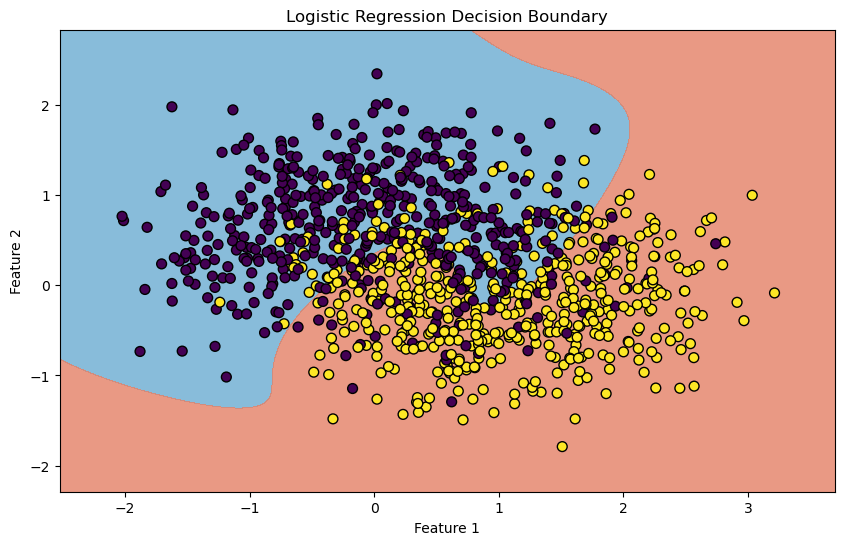

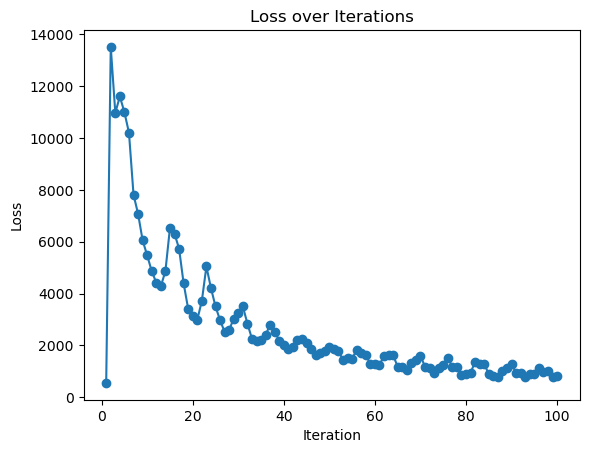

Hyperparameters: gamma for rbf_kernel: 1.0, lambda: 10, learning_rate: 1/i, iter: 100
Number of zero coefficients: 0
w_kern: [ 1.25184754e-03  1.52133667e-01  4.98423340e-02 -2.80810200e+00
 -2.19880651e+00  8.84691823e-01  5.10169802e-01  9.08078279e-01
  4.24530340e-01  3.93834104e-01  6.68465541e-02  2.40470211e+00
  1.09555489e-01 -8.39521128e-01  7.71200061e-02 -3.83387029e-02
  5.42085309e-01  3.94276875e+00  5.23266865e-01  9.84055416e-02
  5.82346398e-01]
Test Accuracy: 75.00%


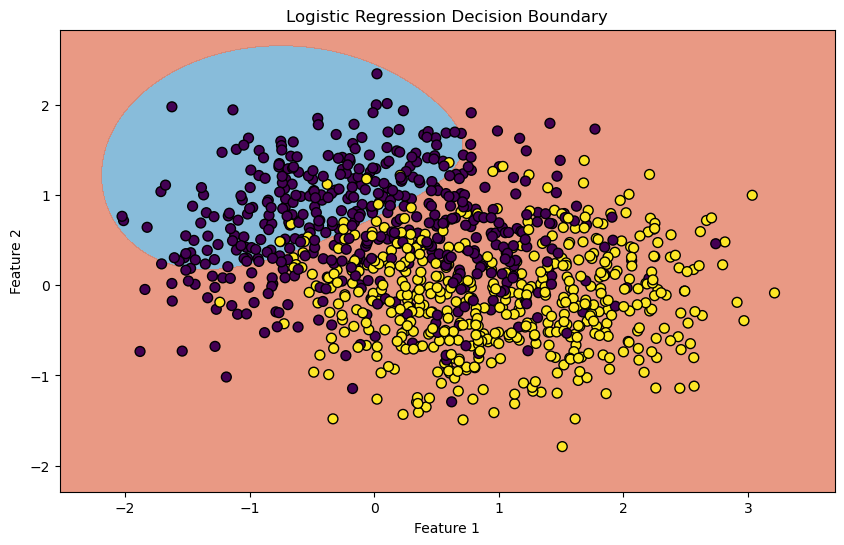

In [36]:
# Test using rbf-kernel:
np.random.seed(42)
centroids = x_train[np.random.choice(x_train.shape[0], 20, replace=False)]

gamma = 1.0
lamdas = [0.001,0.01,0.1,1,10]

for lamda in lamdas:
    x_train_kernel = rbf_kernel(x_train, centroids, gamma)
    x_test_kernel = rbf_kernel(x_test, centroids, gamma)

    w_ker = logistic_regression_L1_reg_train(x_train_kernel, y_train, lamda=lamda, nr_iters=100, C=1)
    print(f"Hyperparameters: gamma for rbf_kernel: {gamma}, lambda: {lamda}, learning_rate: 1/i, iter: 100")
    print(f"Number of zero coefficients: {zero_coeff}")
    print(f"w_kern: {w_ker}")
    evaluate_model(x_test_kernel, y_test, w_ker)
    draw_decision_boundary(X, y, w_ker, centroids, gamma, kernel=True)

    zero_coeff = np.sum(w_ker == 0)

- with these hyperparameters I archived a test accurancy of 81%:
- Hyperparameters: 
  - gamma for rbf_kernel: 1.0 
  - lambda for regularisation: 1
  - dynamic learning_rate: C=1

C:\Users\antom\AppData\Local\Temp\ipykernel_13144\3564089516.py:20: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-z))


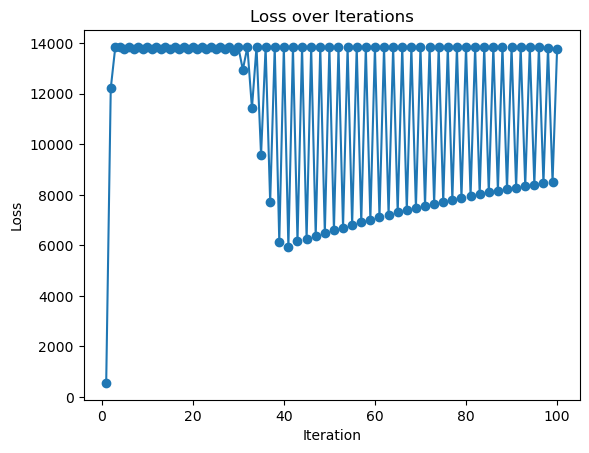

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=1, M=2, lambda=0.001
Number of zero coefficients: 0


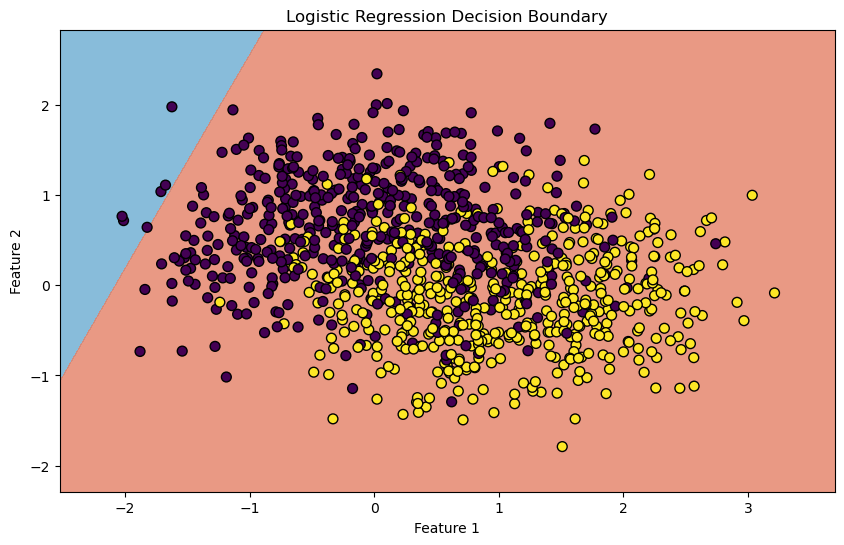

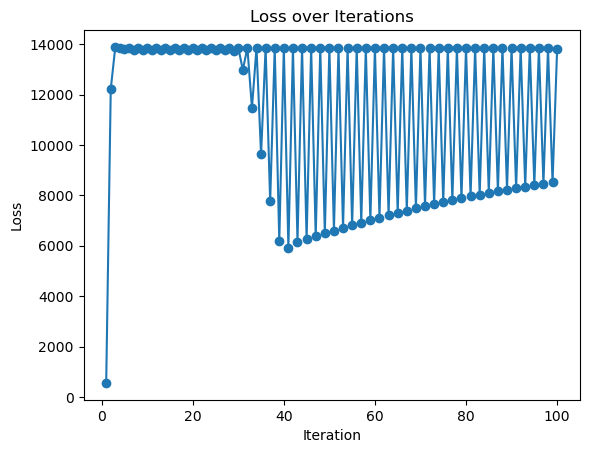

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=1, M=2, lambda=0.01
Number of zero coefficients: 0


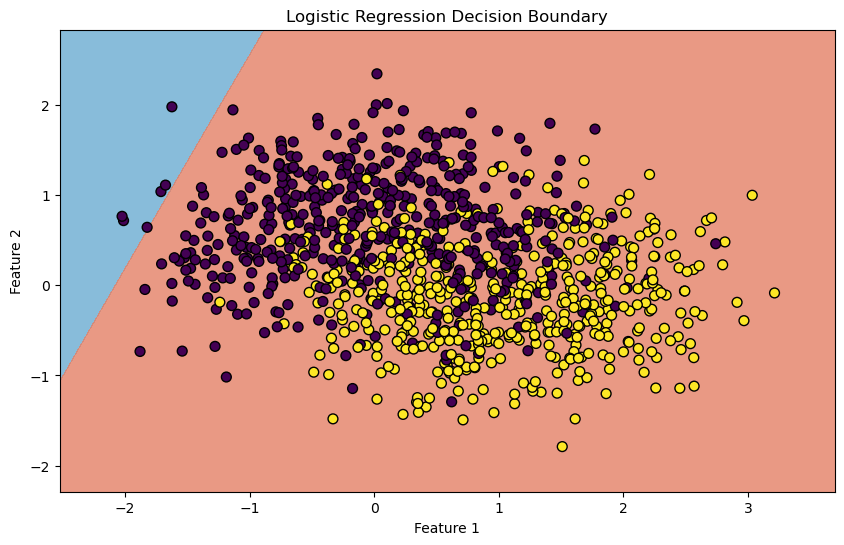

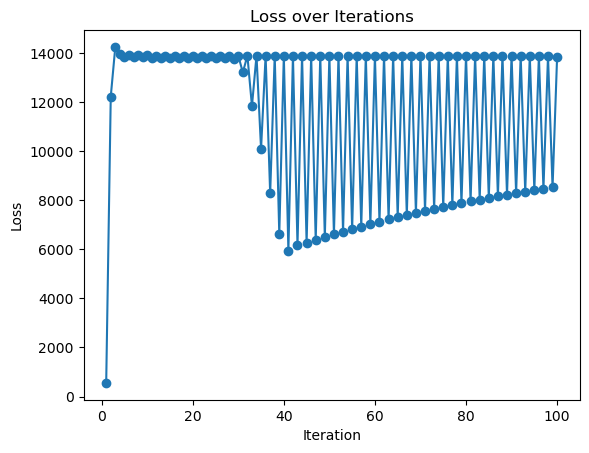

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=1, M=2, lambda=0.1
Number of zero coefficients: 0


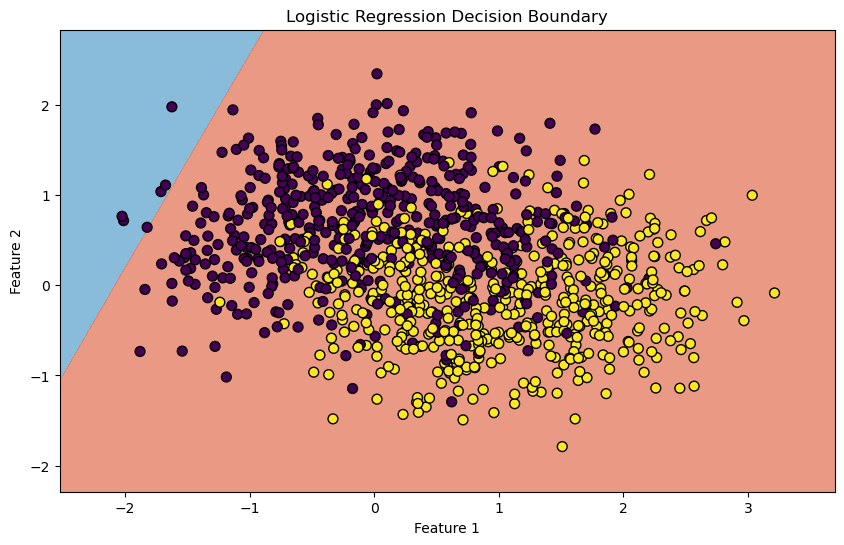

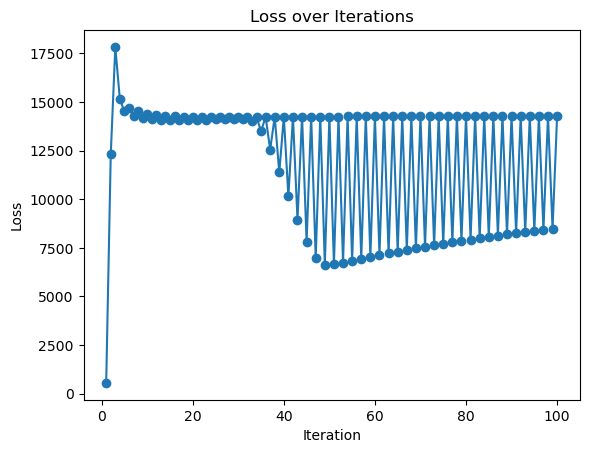

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=1, M=2, lambda=1
Number of zero coefficients: 0


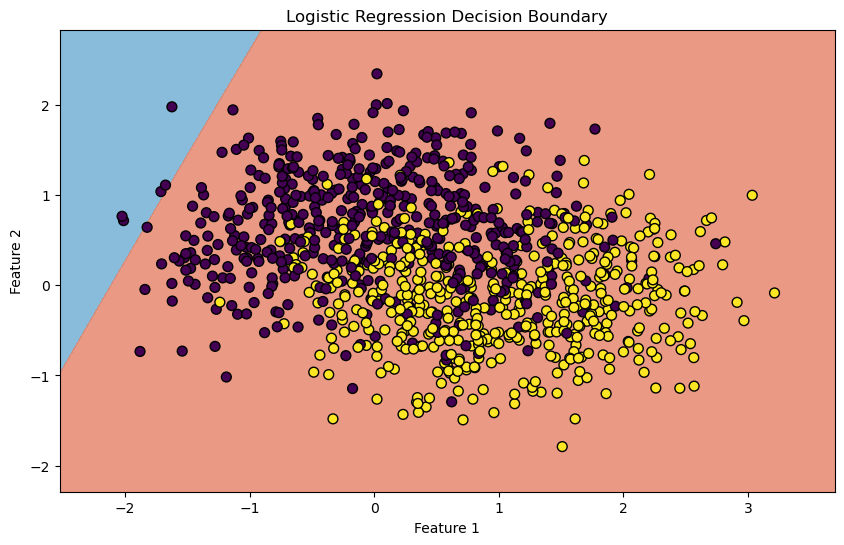

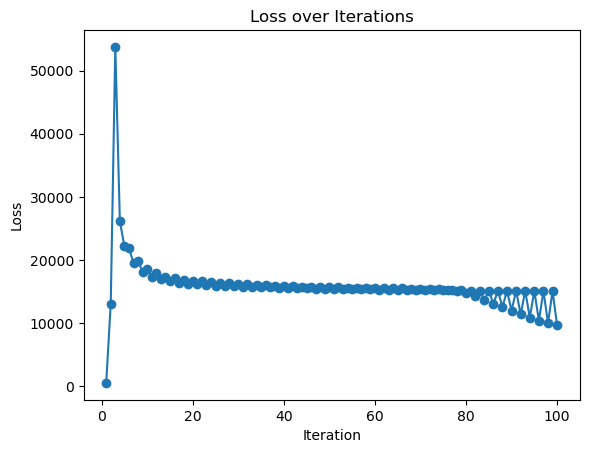

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=1, M=2, lambda=10
Number of zero coefficients: 0


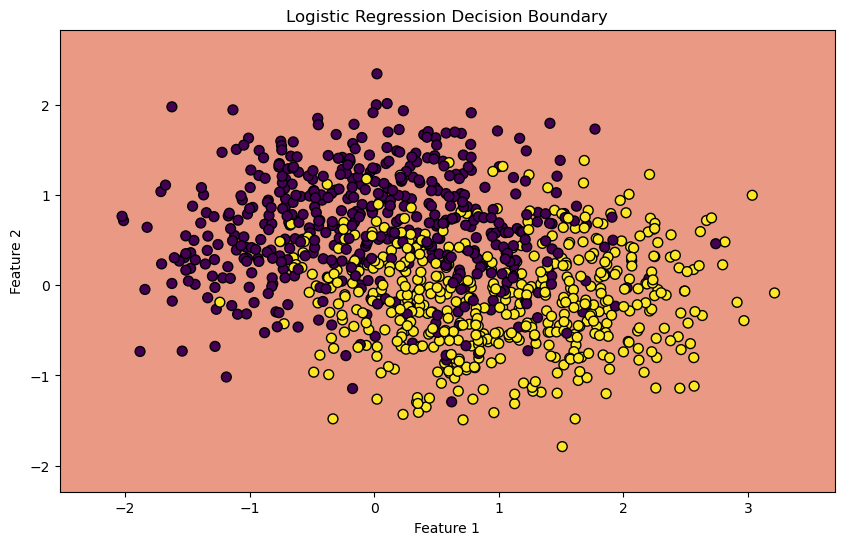

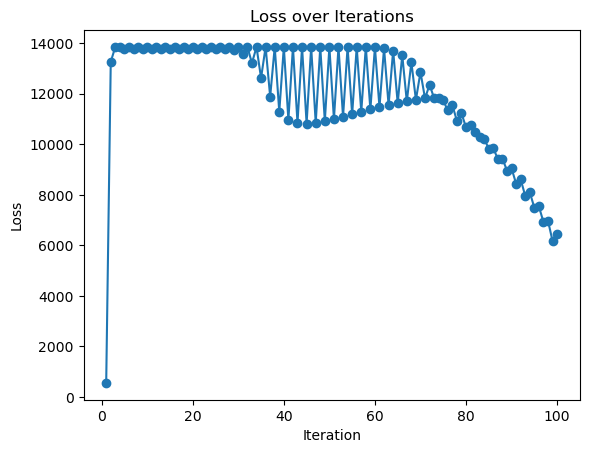

Test Accuracy: 65.00%
Hyperparameters: gamma=0.01, r=1, M=3, lambda=0.001
Number of zero coefficients: 0


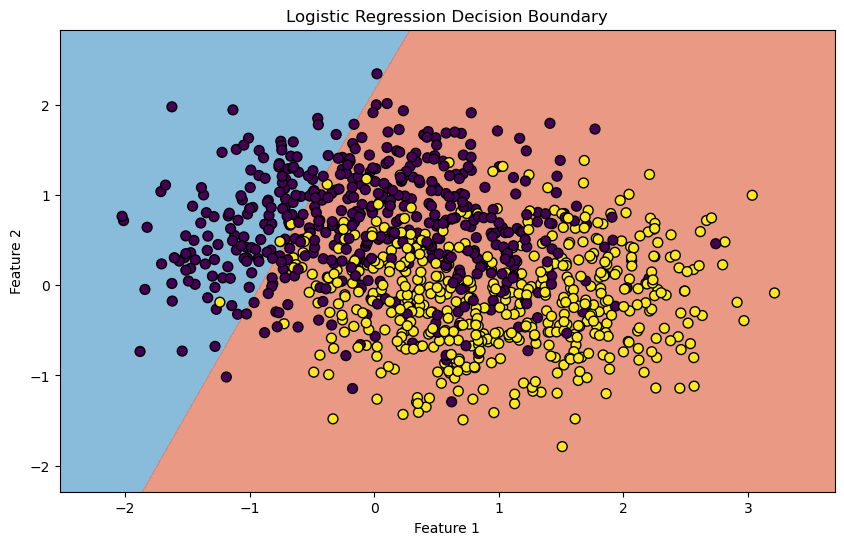

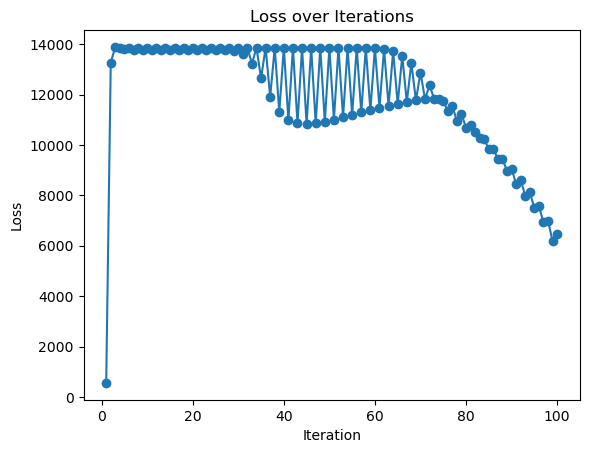

Test Accuracy: 65.00%
Hyperparameters: gamma=0.01, r=1, M=3, lambda=0.01
Number of zero coefficients: 0


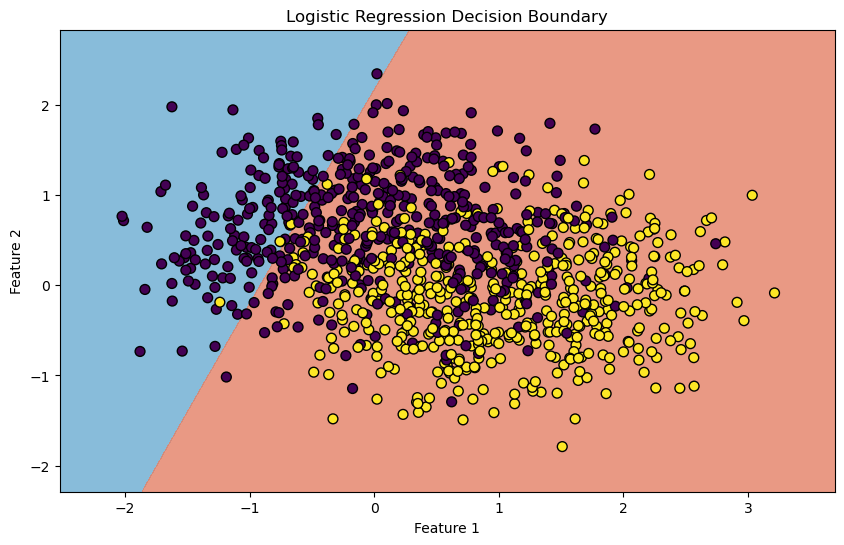

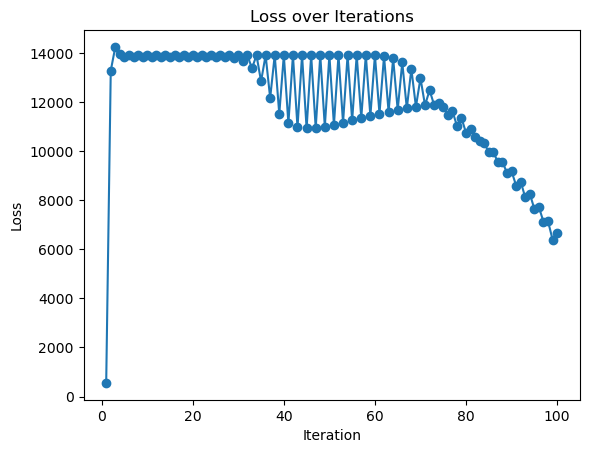

Test Accuracy: 65.00%
Hyperparameters: gamma=0.01, r=1, M=3, lambda=0.1
Number of zero coefficients: 0


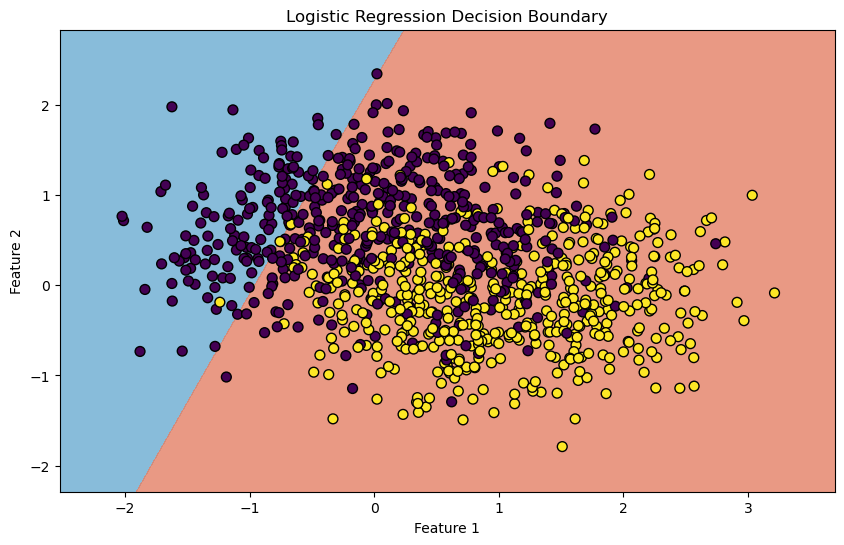

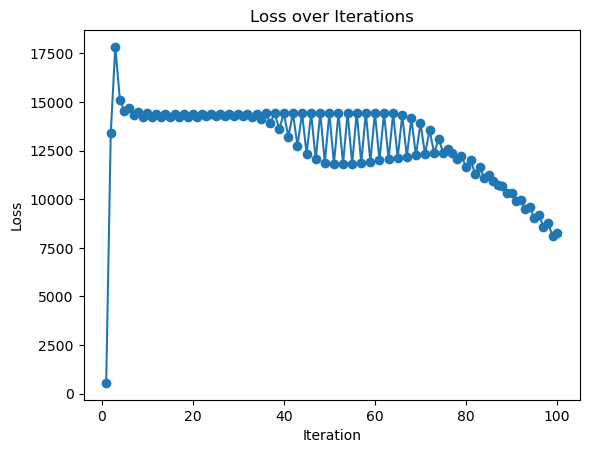

Test Accuracy: 60.00%
Hyperparameters: gamma=0.01, r=1, M=3, lambda=1
Number of zero coefficients: 0


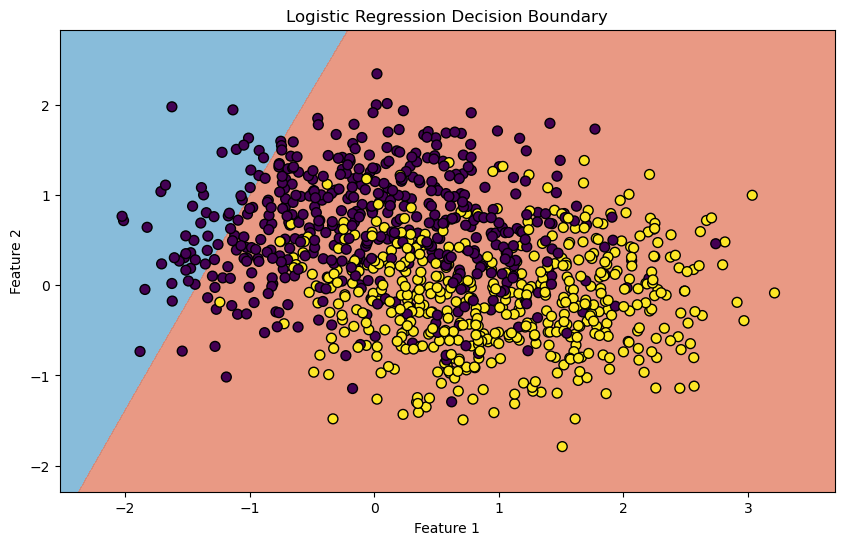

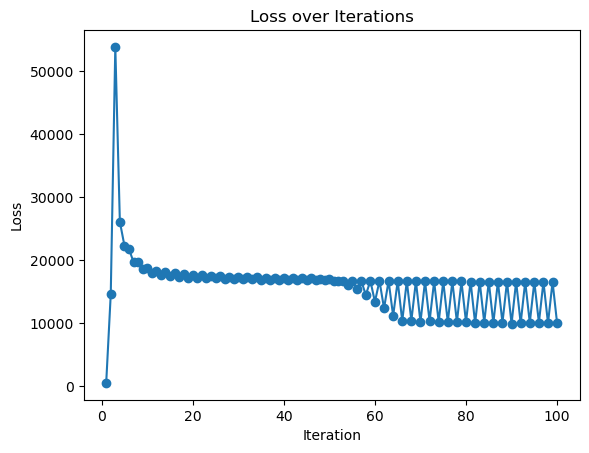

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=1, M=3, lambda=10
Number of zero coefficients: 0


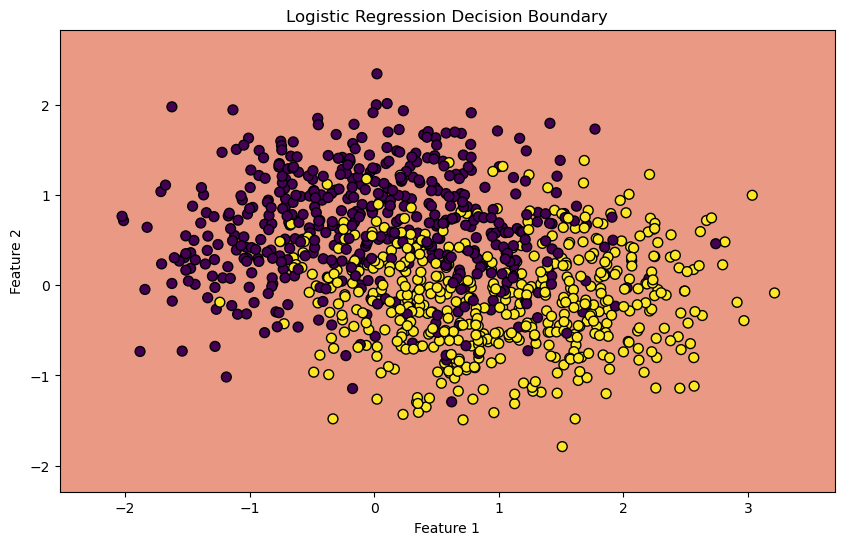

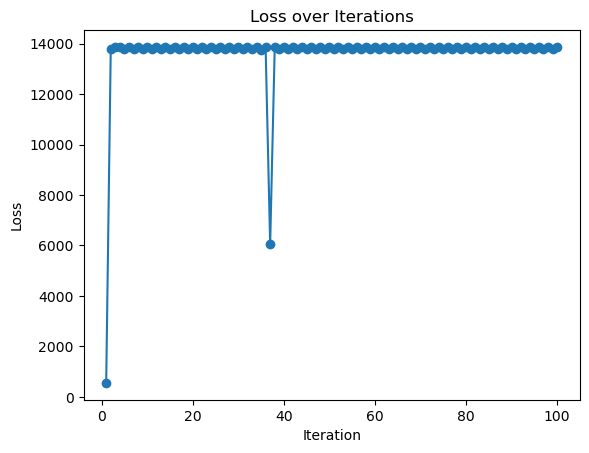

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=2, lambda=0.001
Number of zero coefficients: 0


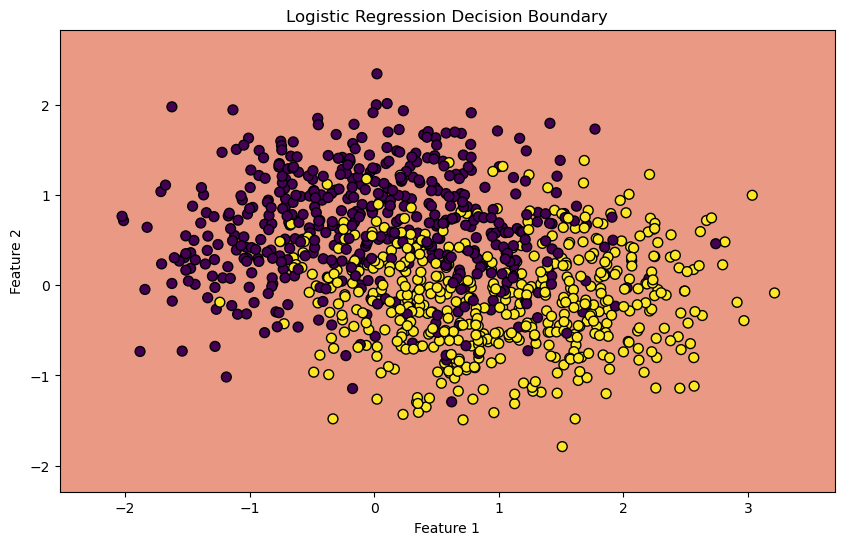

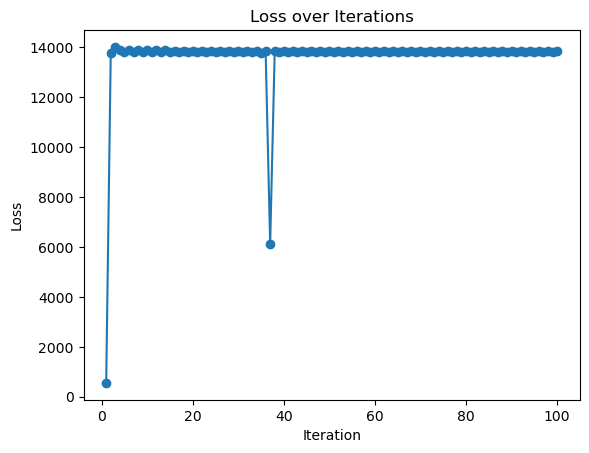

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=2, lambda=0.01
Number of zero coefficients: 0


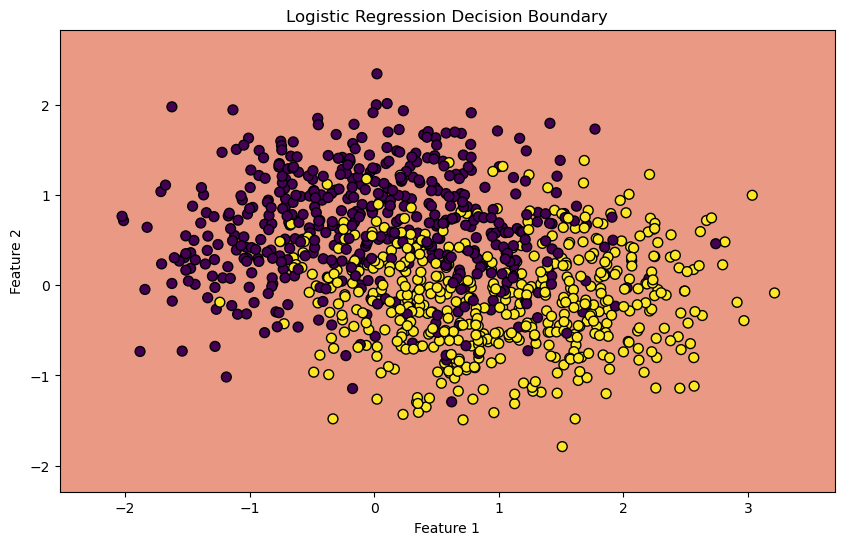

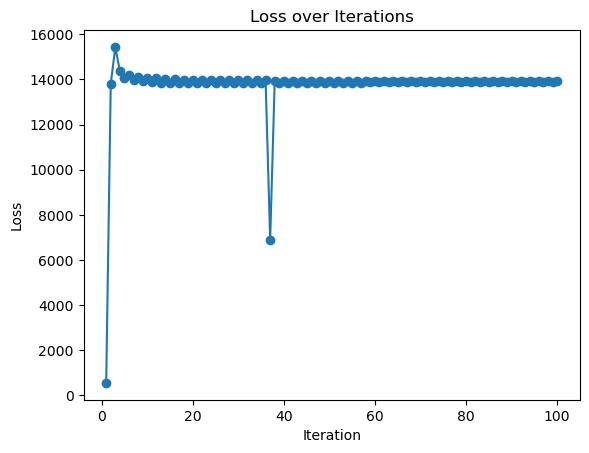

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=2, lambda=0.1
Number of zero coefficients: 0


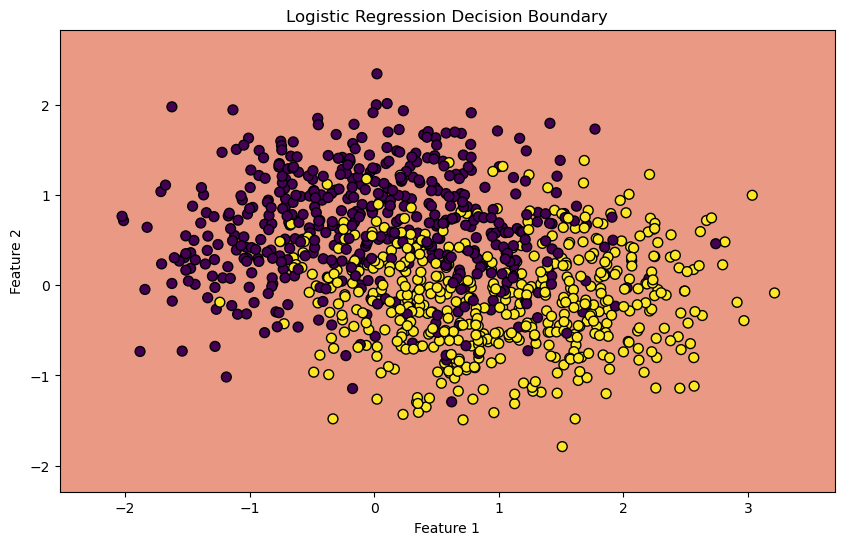

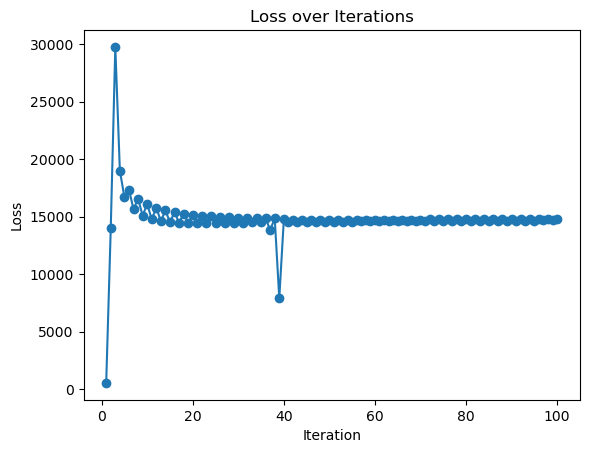

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=2, lambda=1
Number of zero coefficients: 0


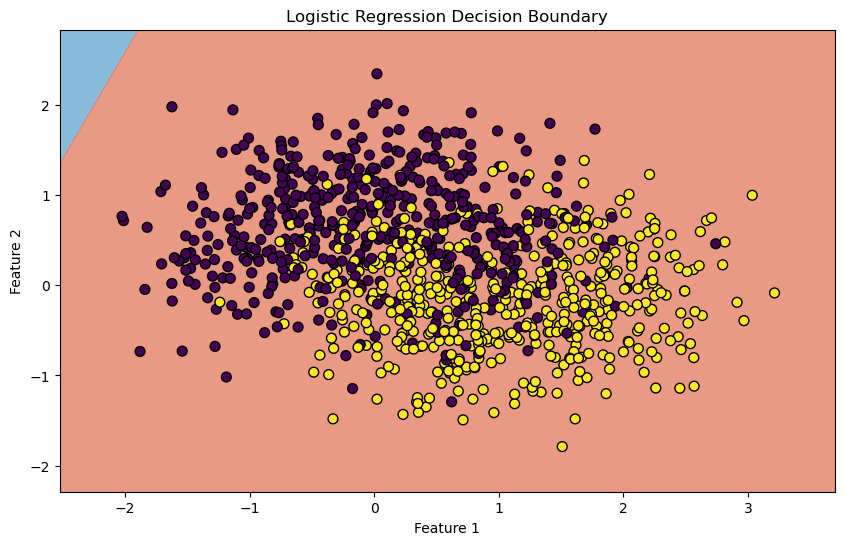

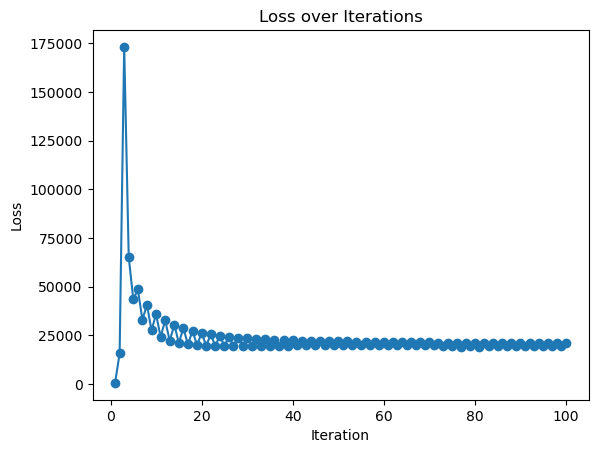

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=2, lambda=10
Number of zero coefficients: 0


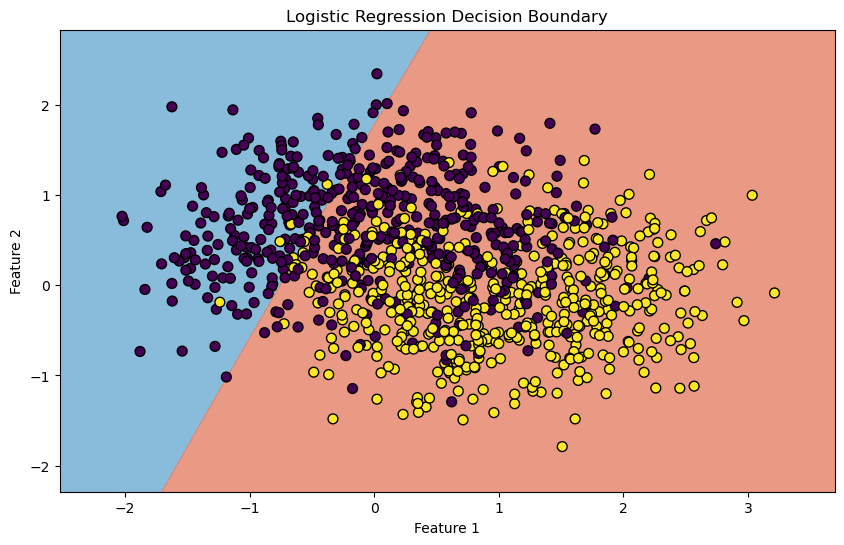

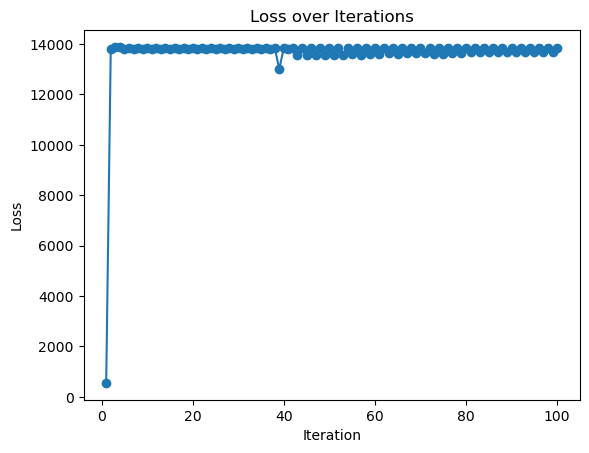

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=3, lambda=0.001
Number of zero coefficients: 0


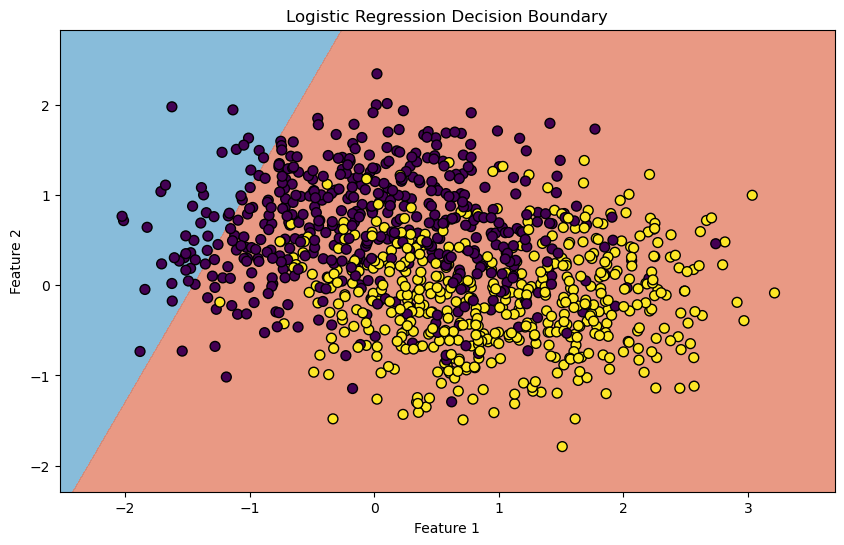

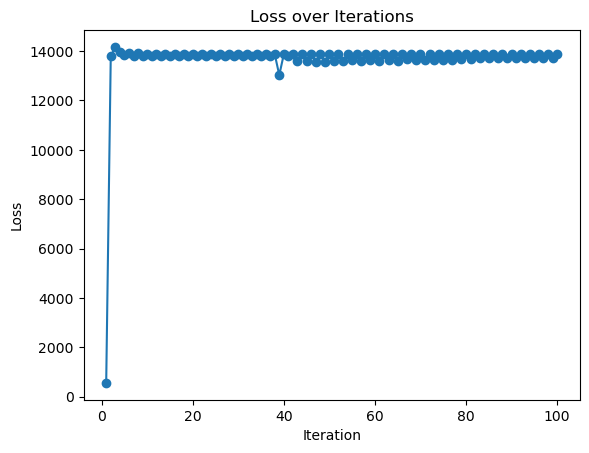

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=3, lambda=0.01
Number of zero coefficients: 0


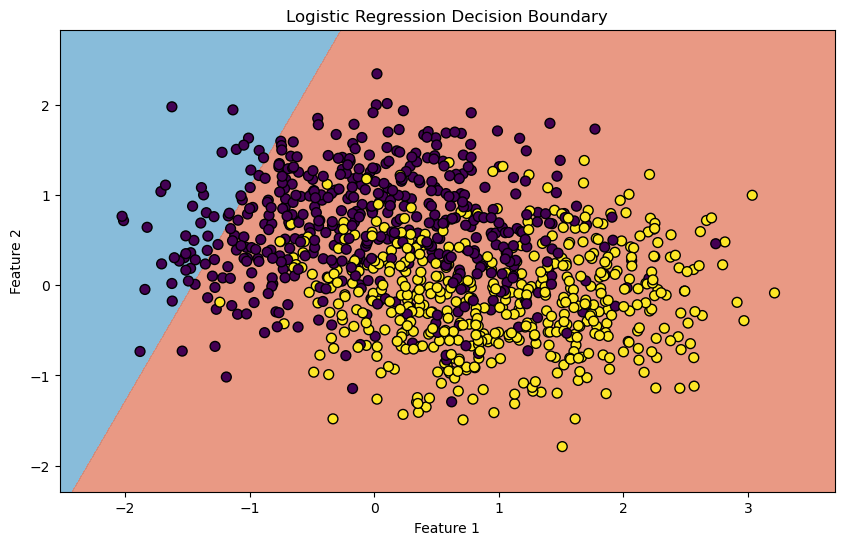

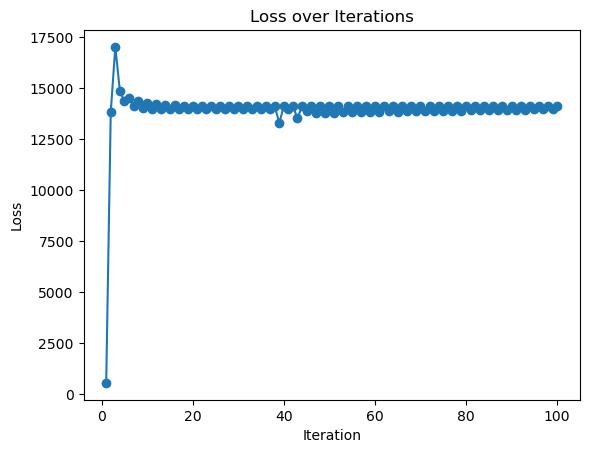

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=3, lambda=0.1
Number of zero coefficients: 0


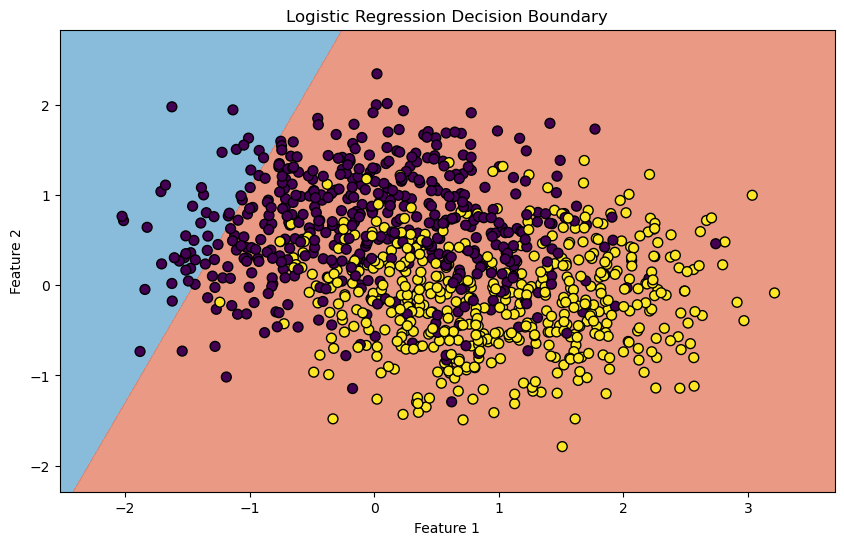

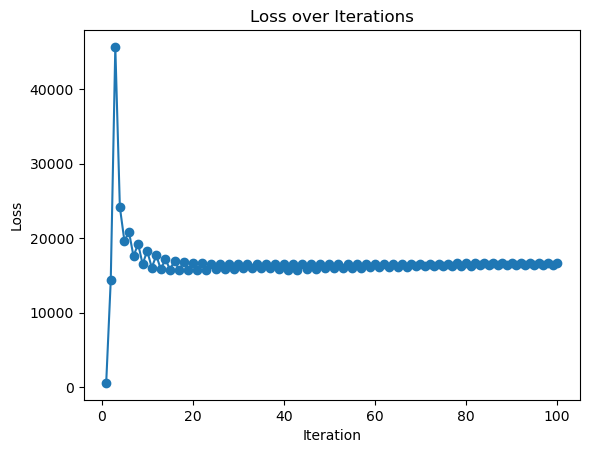

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=3, lambda=1
Number of zero coefficients: 0


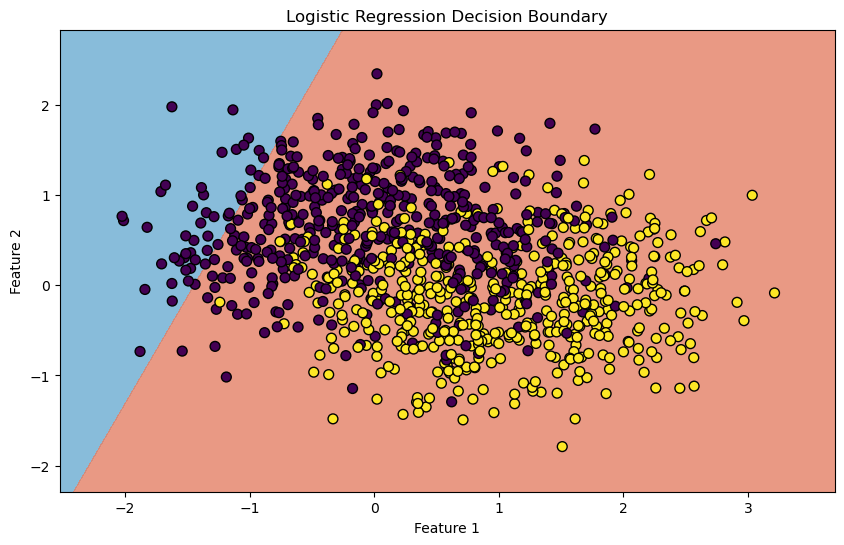

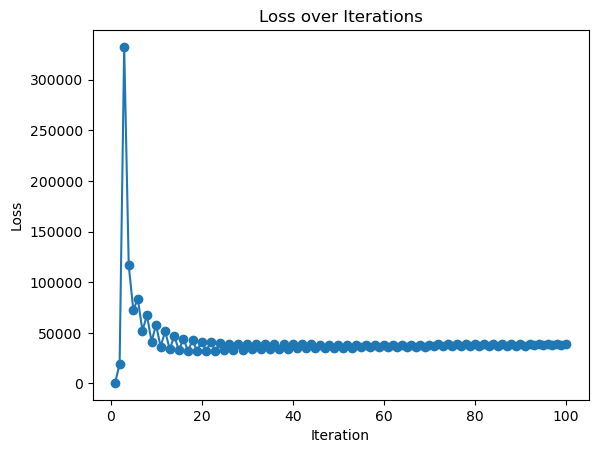

Test Accuracy: 53.00%
Hyperparameters: gamma=0.01, r=2, M=3, lambda=10
Number of zero coefficients: 0


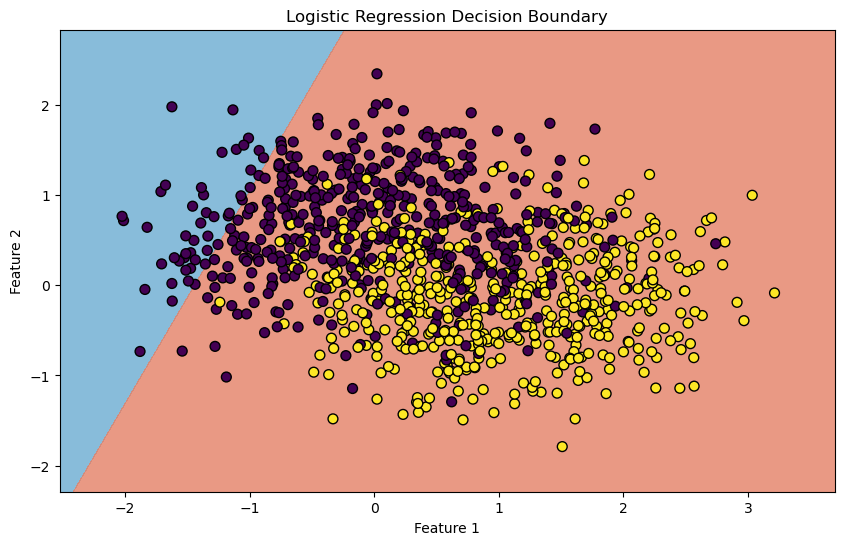

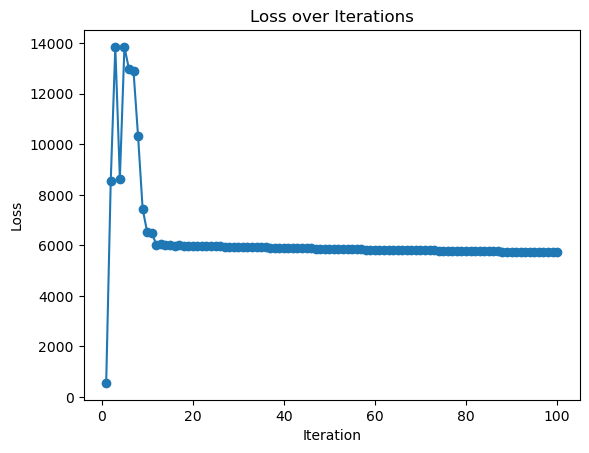

Test Accuracy: 78.00%
Hyperparameters: gamma=0.1, r=1, M=2, lambda=0.001
Number of zero coefficients: 0


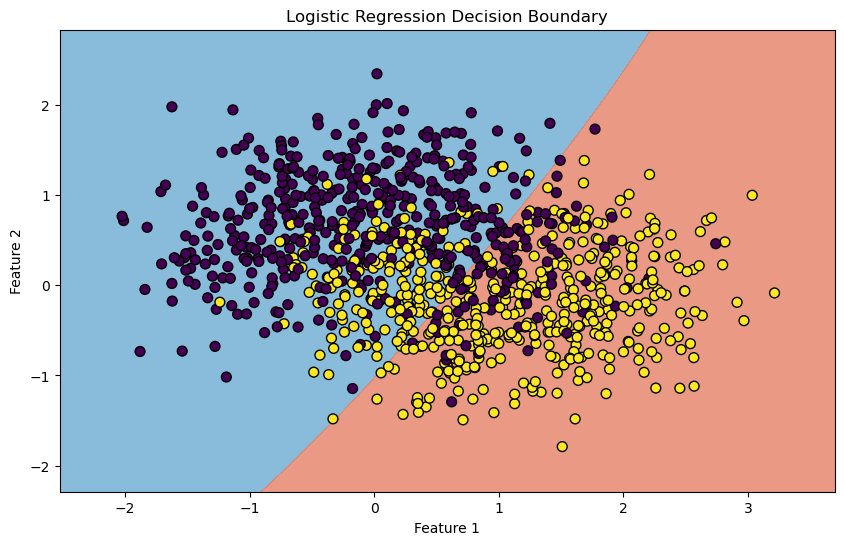

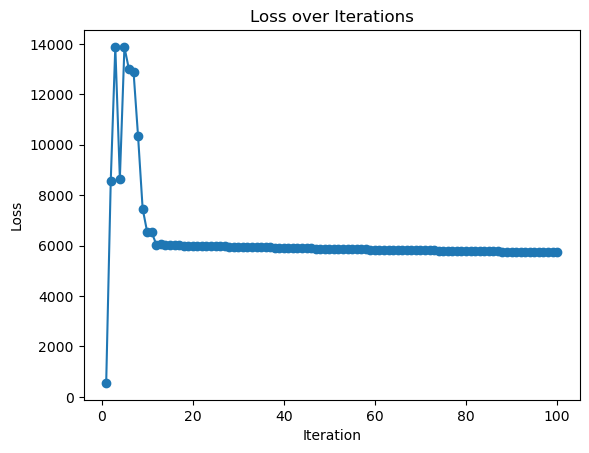

Test Accuracy: 78.00%
Hyperparameters: gamma=0.1, r=1, M=2, lambda=0.01
Number of zero coefficients: 0


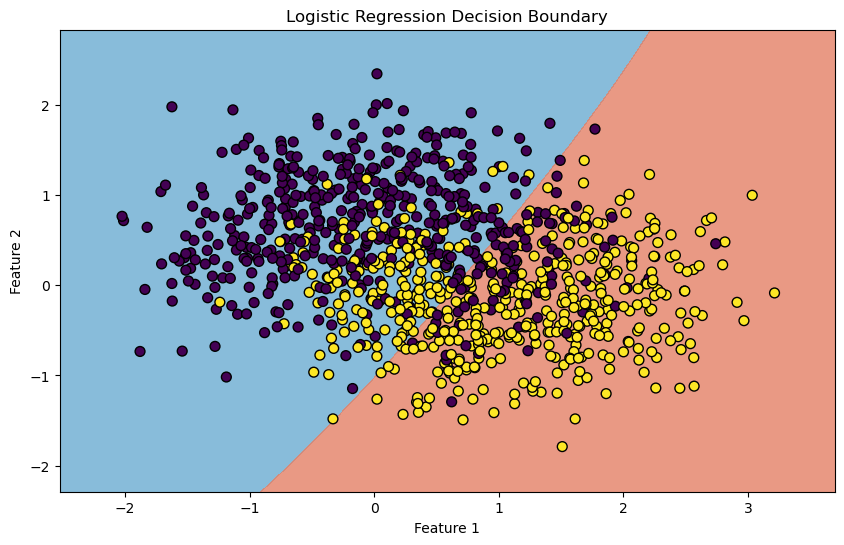

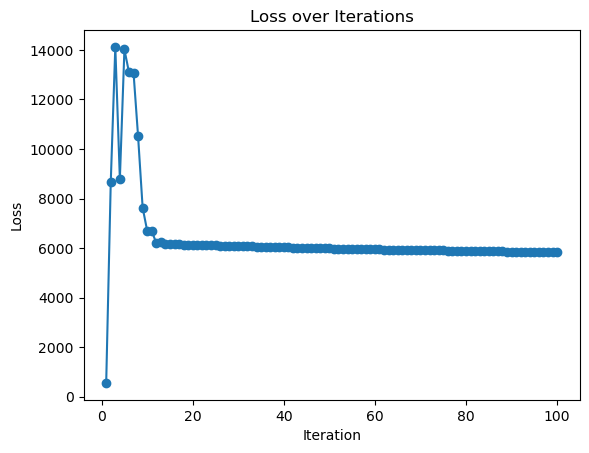

Test Accuracy: 78.00%
Hyperparameters: gamma=0.1, r=1, M=2, lambda=0.1
Number of zero coefficients: 0


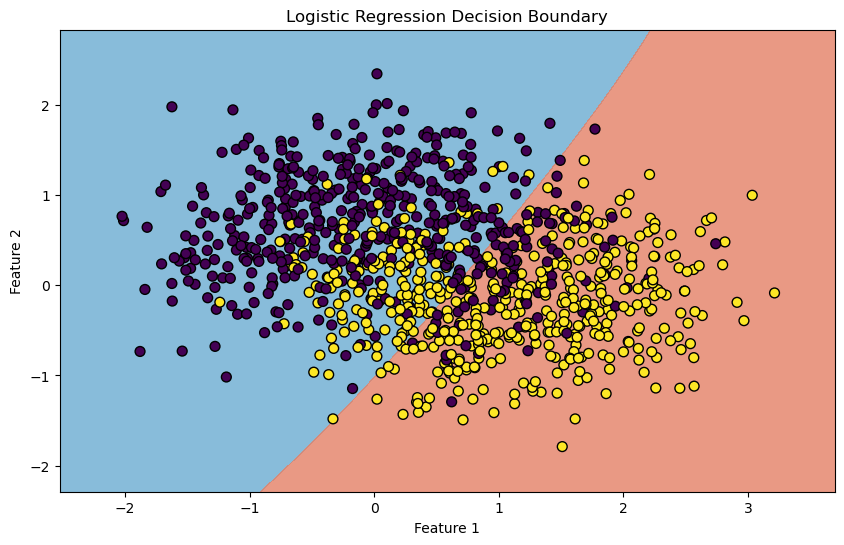

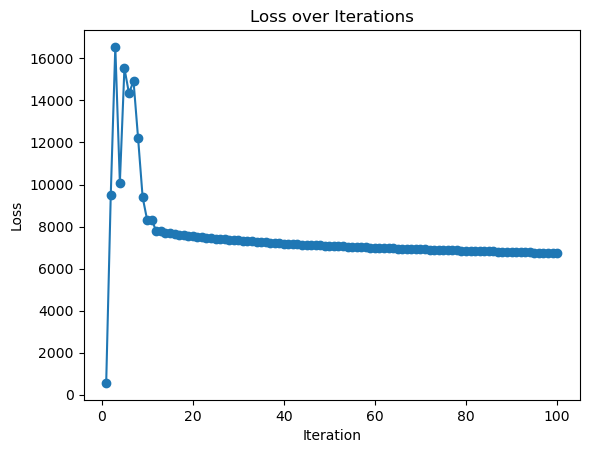

Test Accuracy: 78.00%
Hyperparameters: gamma=0.1, r=1, M=2, lambda=1
Number of zero coefficients: 0


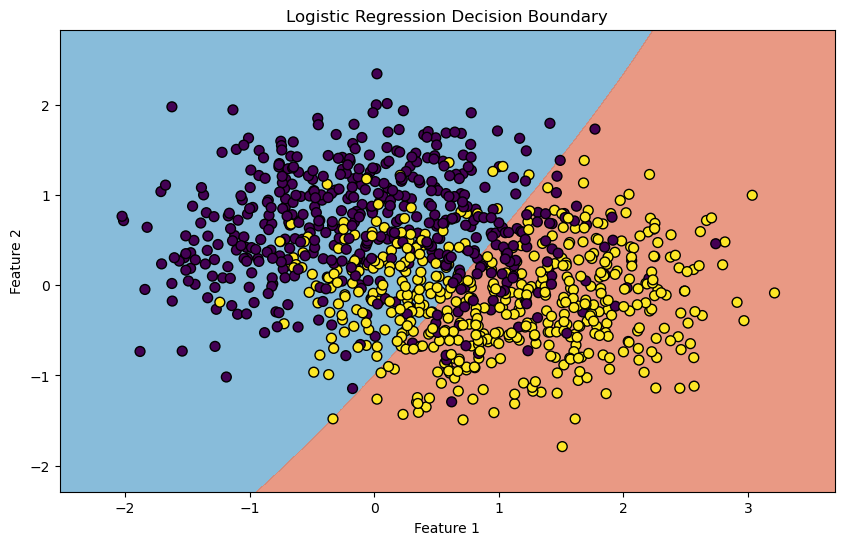

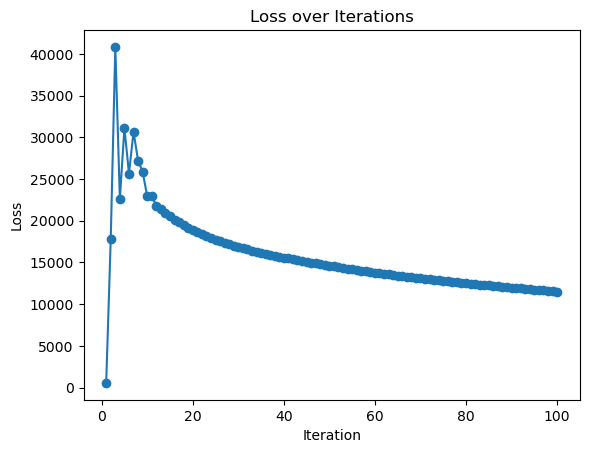

Test Accuracy: 78.00%
Hyperparameters: gamma=0.1, r=1, M=2, lambda=10
Number of zero coefficients: 0


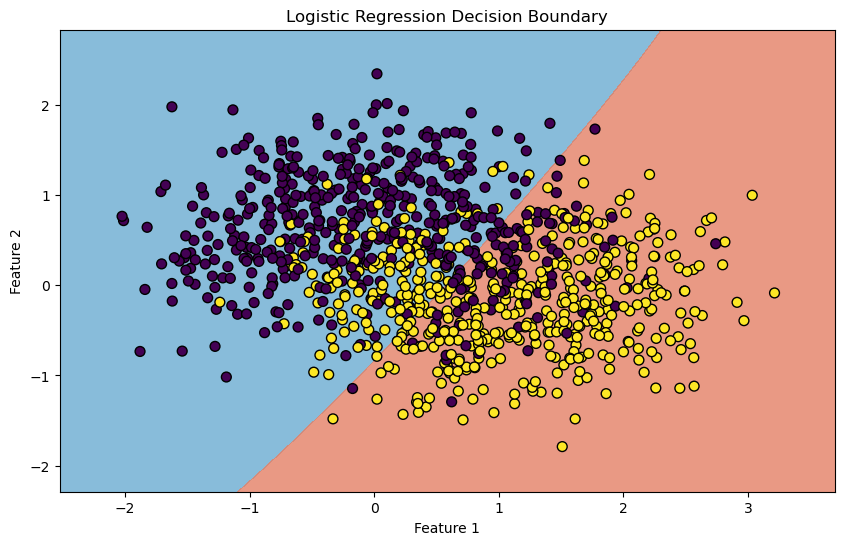

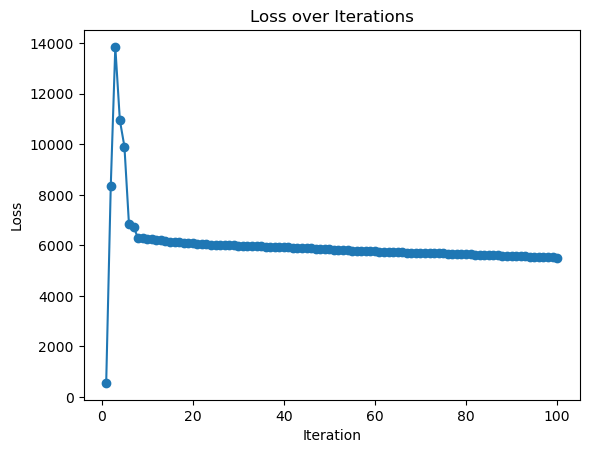

Test Accuracy: 78.00%
Hyperparameters: gamma=0.1, r=1, M=3, lambda=0.001
Number of zero coefficients: 0


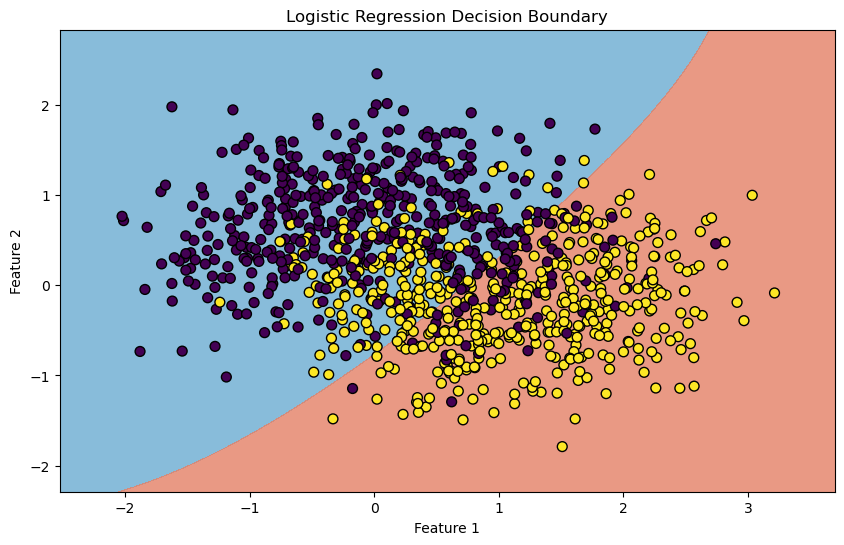

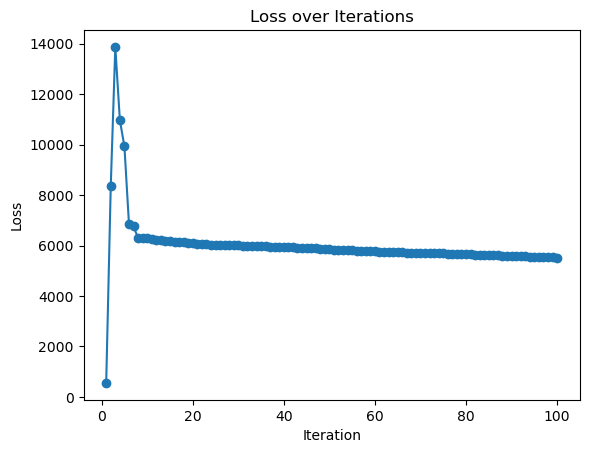

Test Accuracy: 78.00%
Hyperparameters: gamma=0.1, r=1, M=3, lambda=0.01
Number of zero coefficients: 0


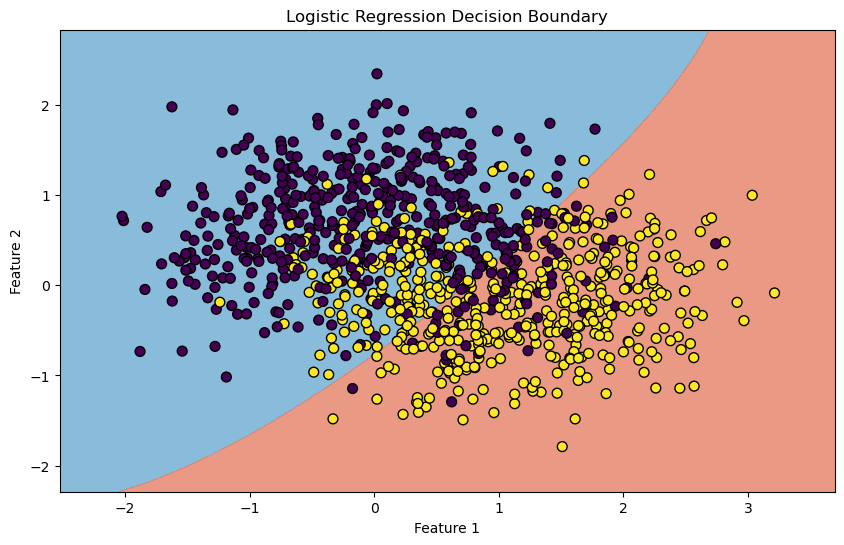

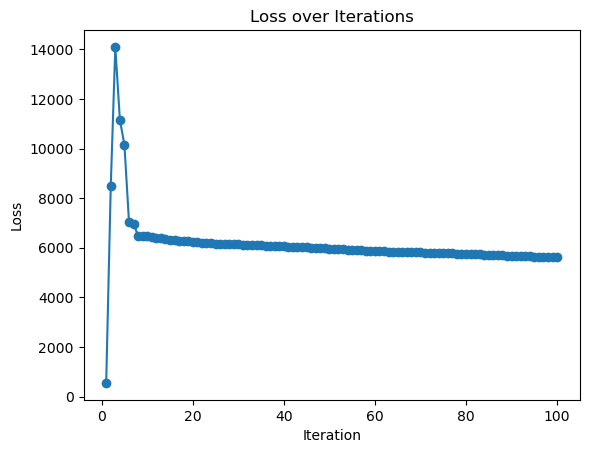

Test Accuracy: 78.00%
Hyperparameters: gamma=0.1, r=1, M=3, lambda=0.1
Number of zero coefficients: 0


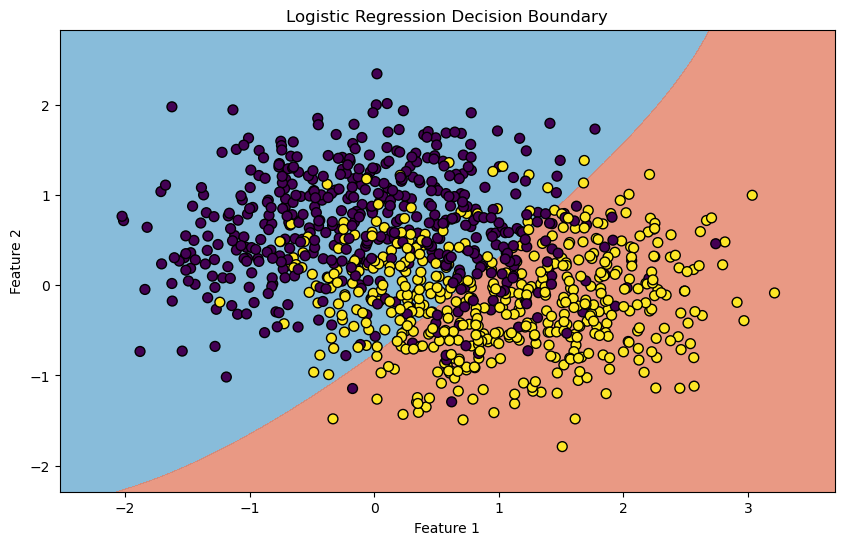

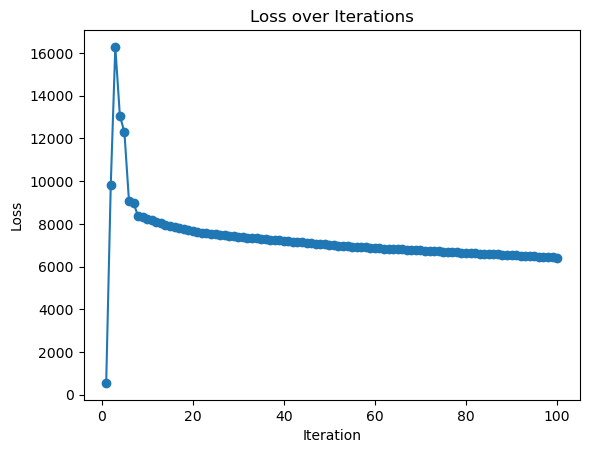

Test Accuracy: 78.00%
Hyperparameters: gamma=0.1, r=1, M=3, lambda=1
Number of zero coefficients: 0


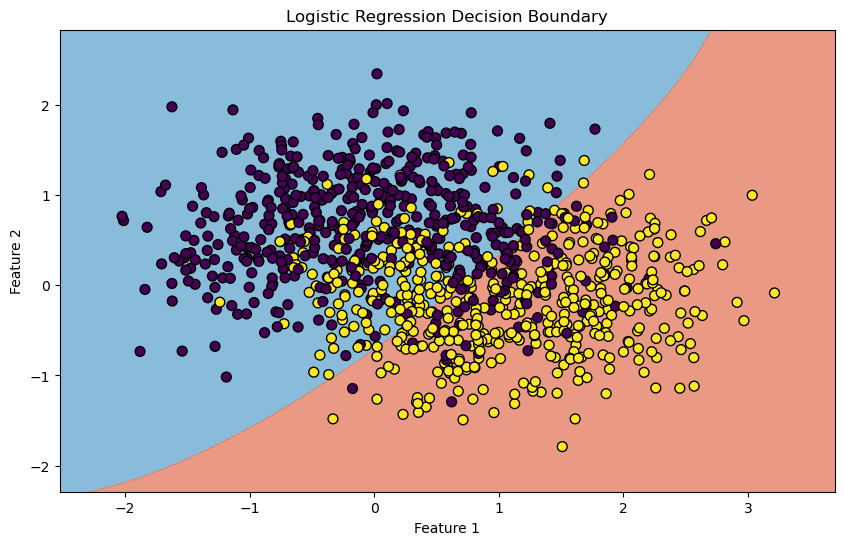

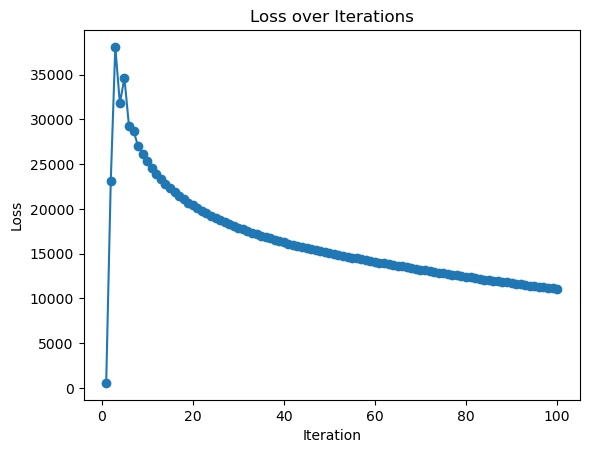

Test Accuracy: 80.00%
Hyperparameters: gamma=0.1, r=1, M=3, lambda=10
Number of zero coefficients: 0


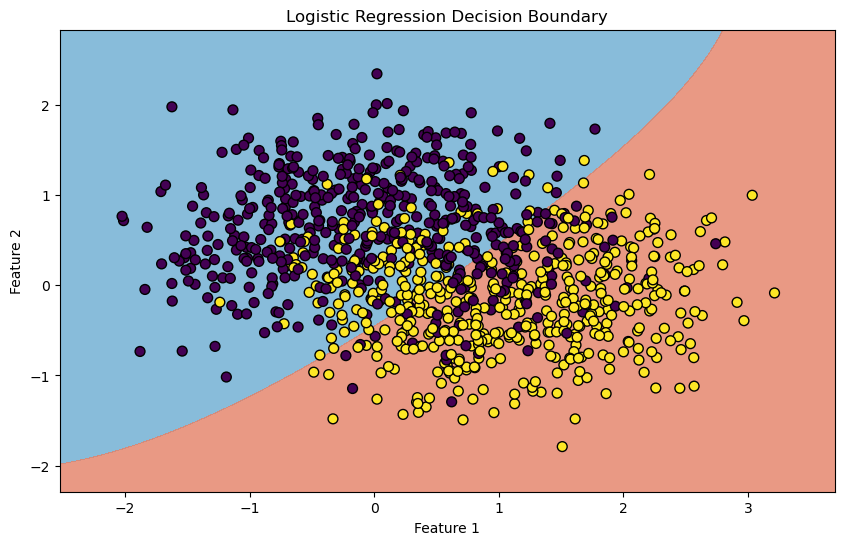

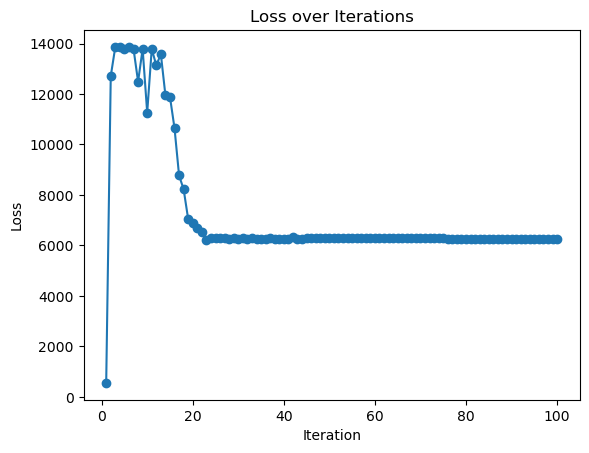

C:\Users\antom\AppData\Local\Temp\ipykernel_13144\3564089516.py:40: RuntimeWarning: overflow encountered in exp
  predictions = (1 / (1 + np.exp(-scores))) >= 0.5


Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=2, lambda=0.001
Number of zero coefficients: 0


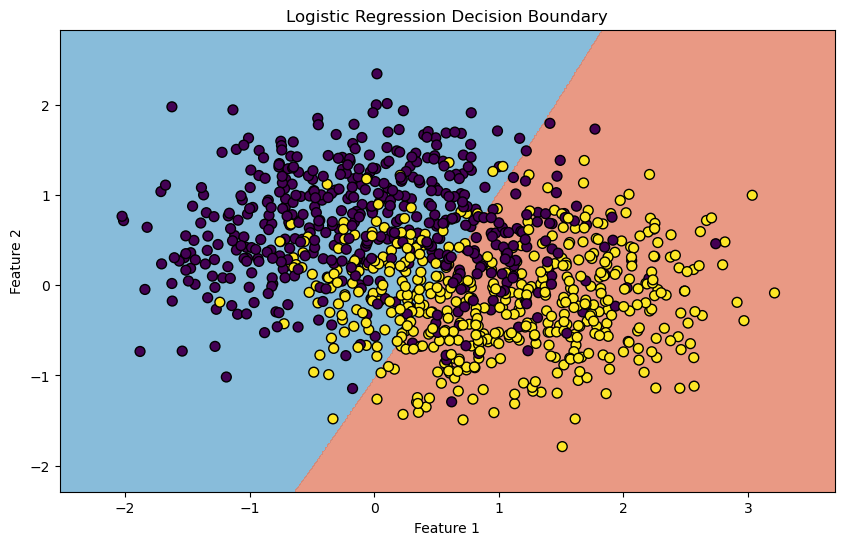

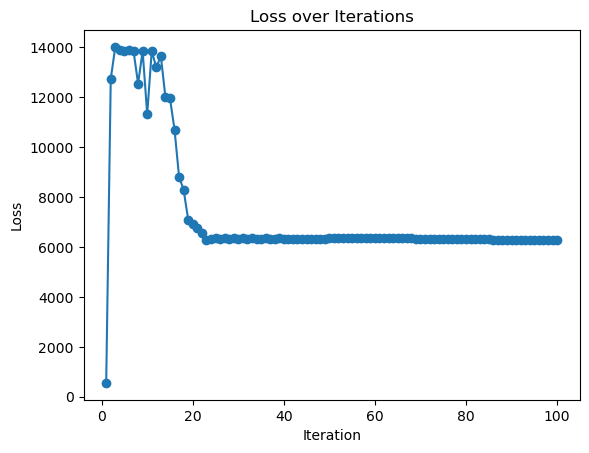

Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=2, lambda=0.01
Number of zero coefficients: 0


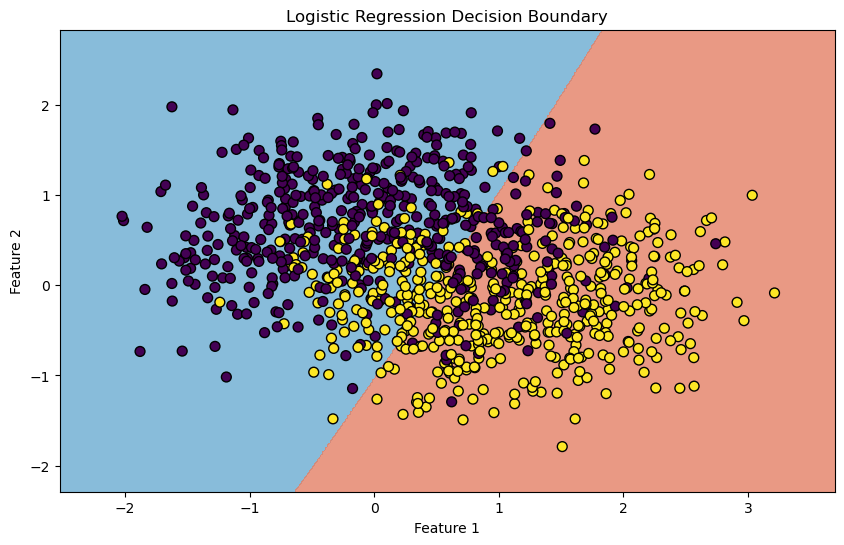

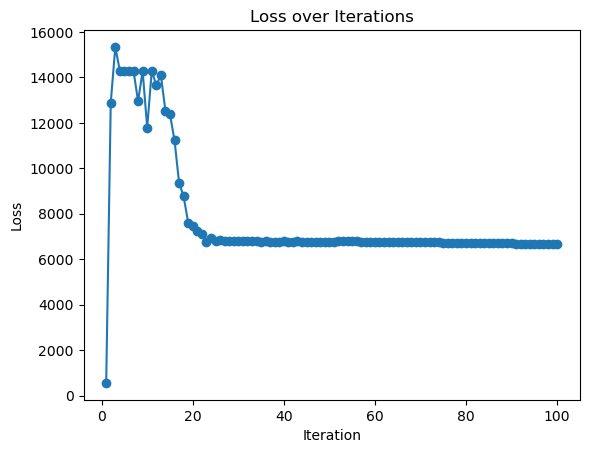

Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=2, lambda=0.1
Number of zero coefficients: 0


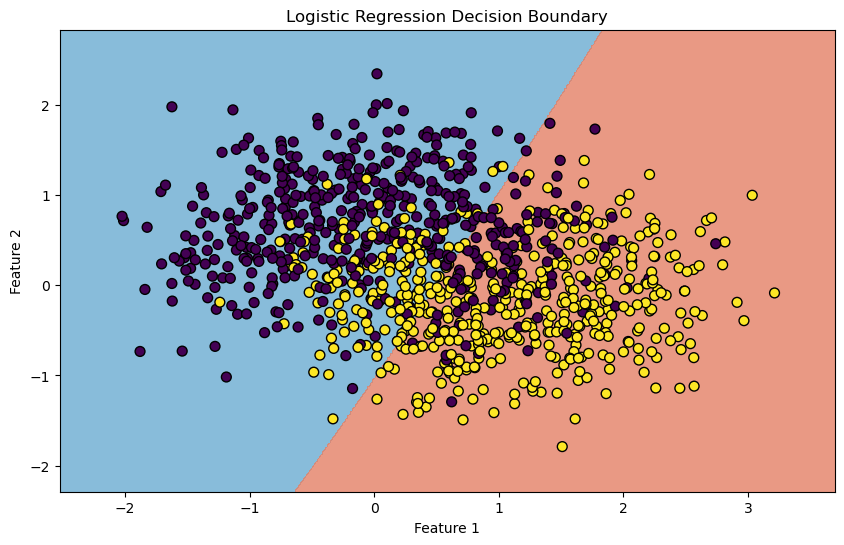

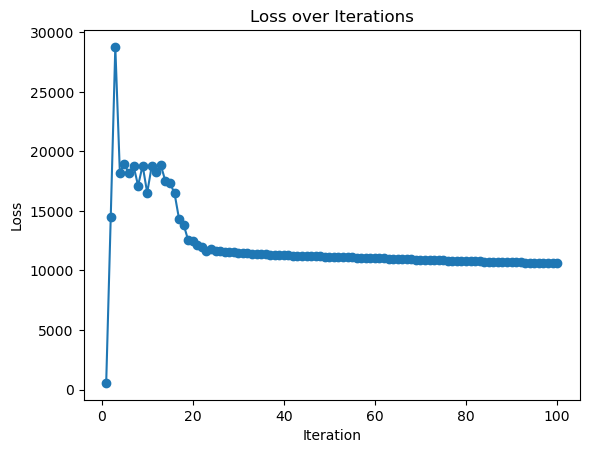

Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=2, lambda=1
Number of zero coefficients: 0


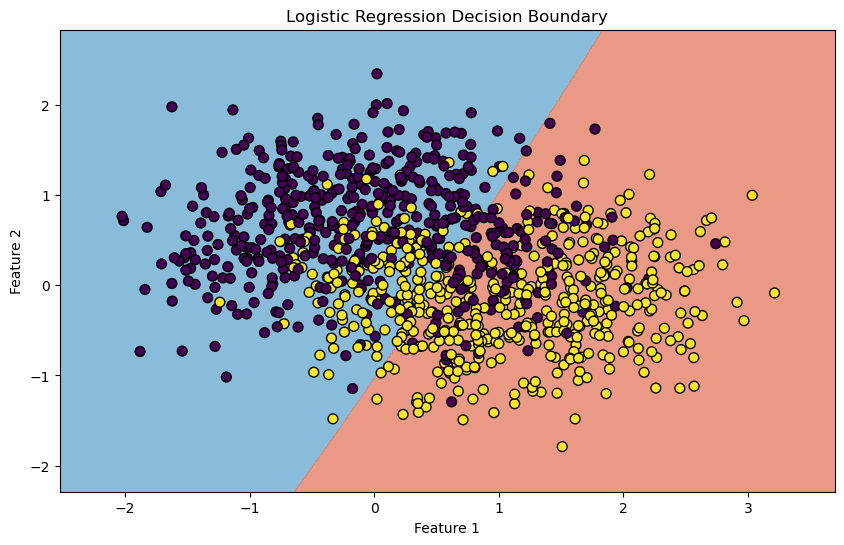

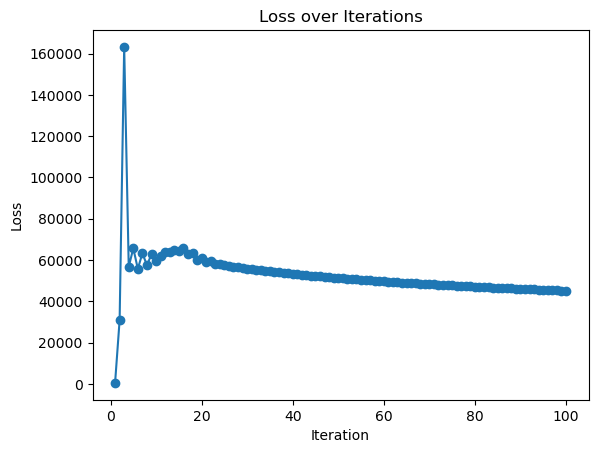

Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=2, lambda=10
Number of zero coefficients: 0


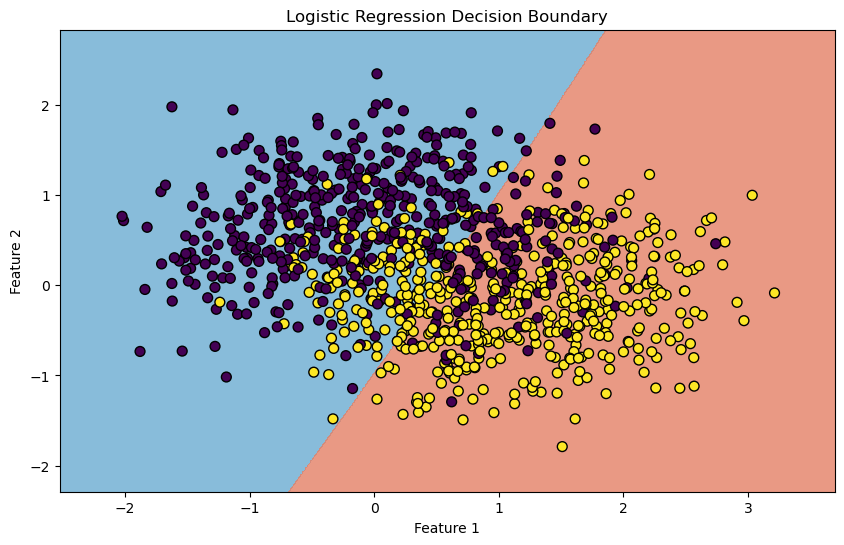

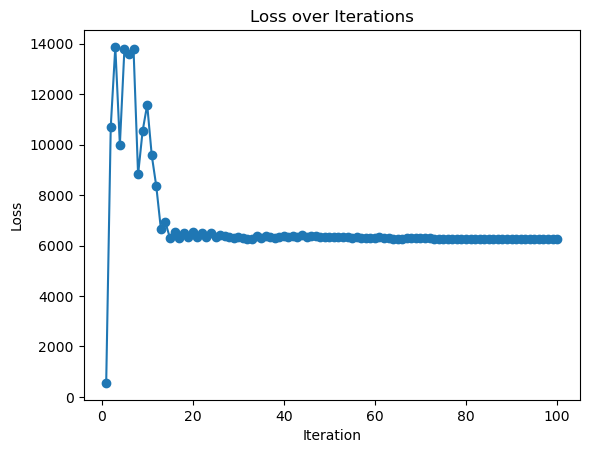

Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=3, lambda=0.001
Number of zero coefficients: 0


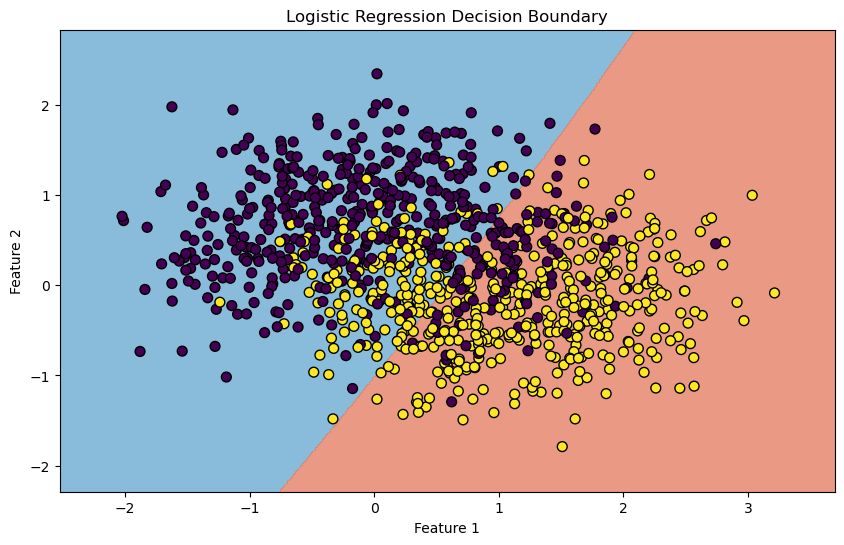

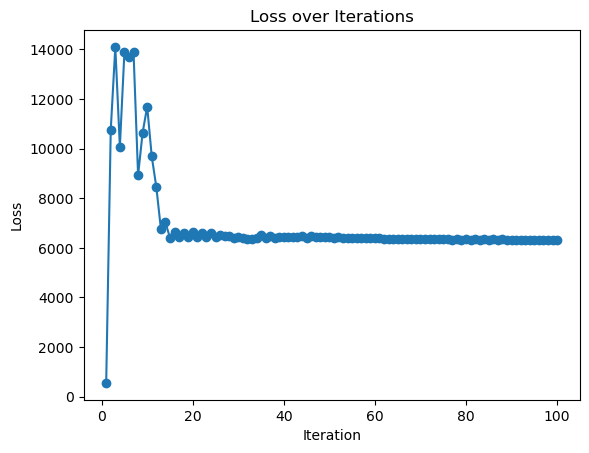

Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=3, lambda=0.01
Number of zero coefficients: 0


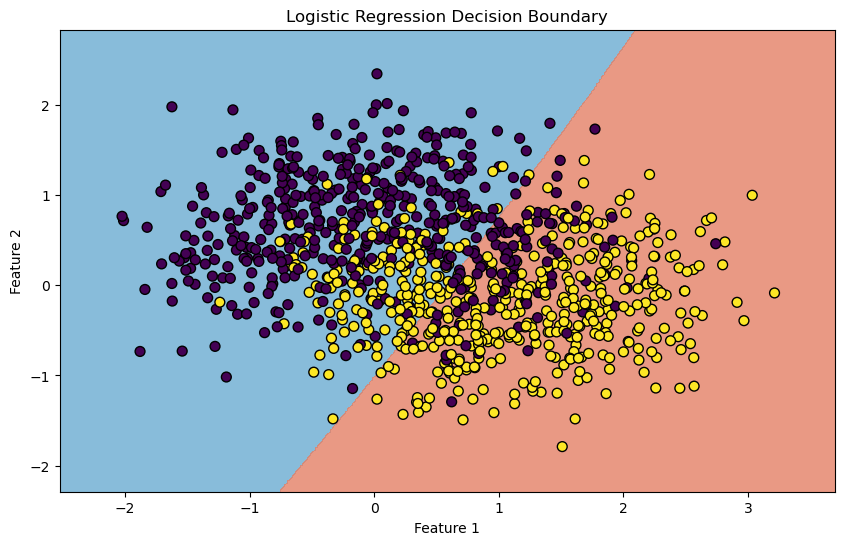

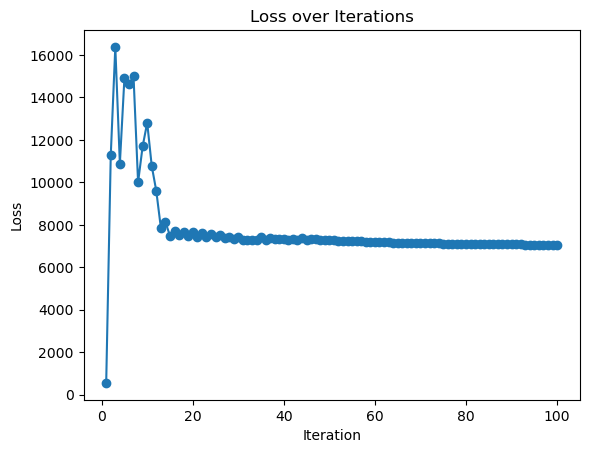

Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=3, lambda=0.1
Number of zero coefficients: 0


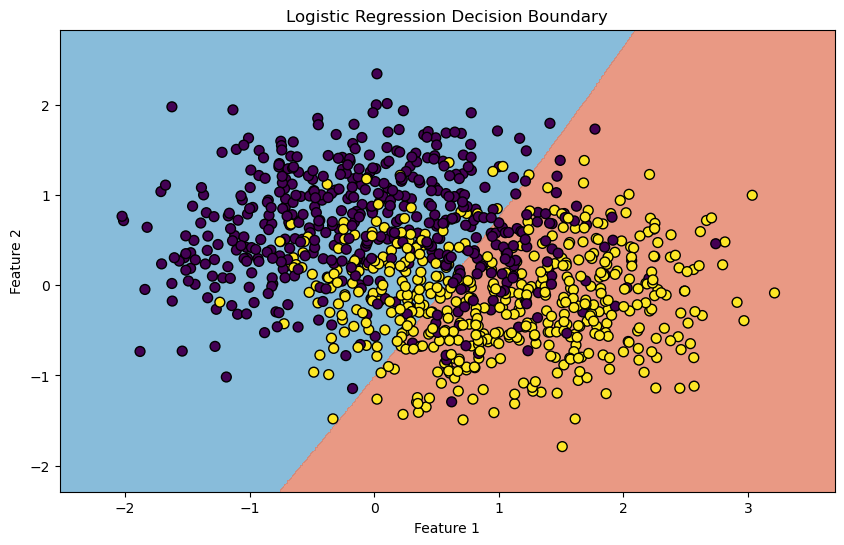

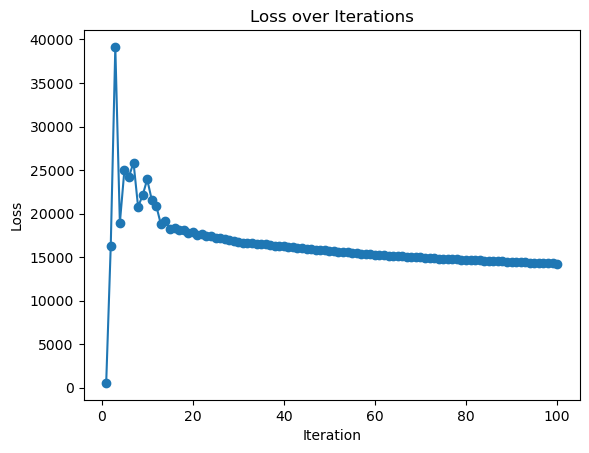

Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=3, lambda=1
Number of zero coefficients: 0


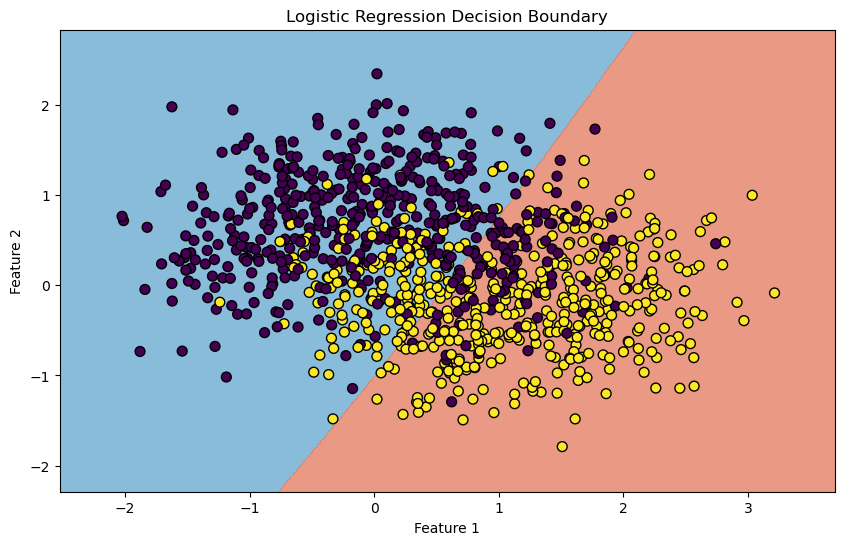

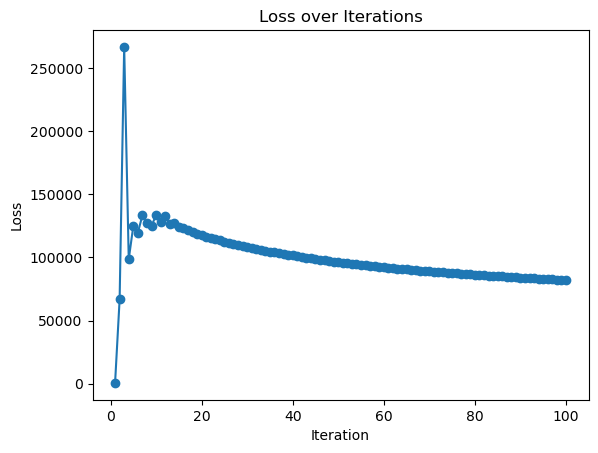

Test Accuracy: 76.00%
Hyperparameters: gamma=0.1, r=2, M=3, lambda=10
Number of zero coefficients: 0


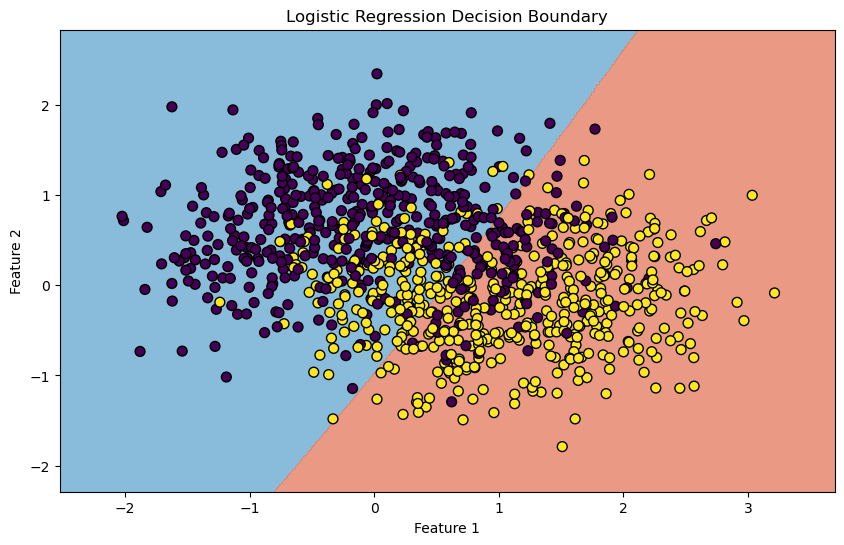

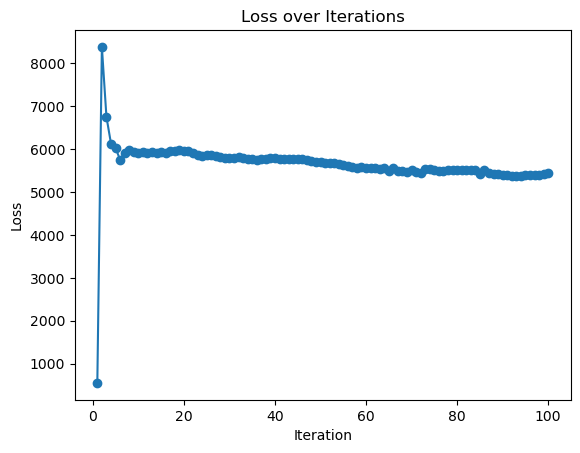

Test Accuracy: 77.00%
Hyperparameters: gamma=1, r=1, M=2, lambda=0.001
Number of zero coefficients: 0


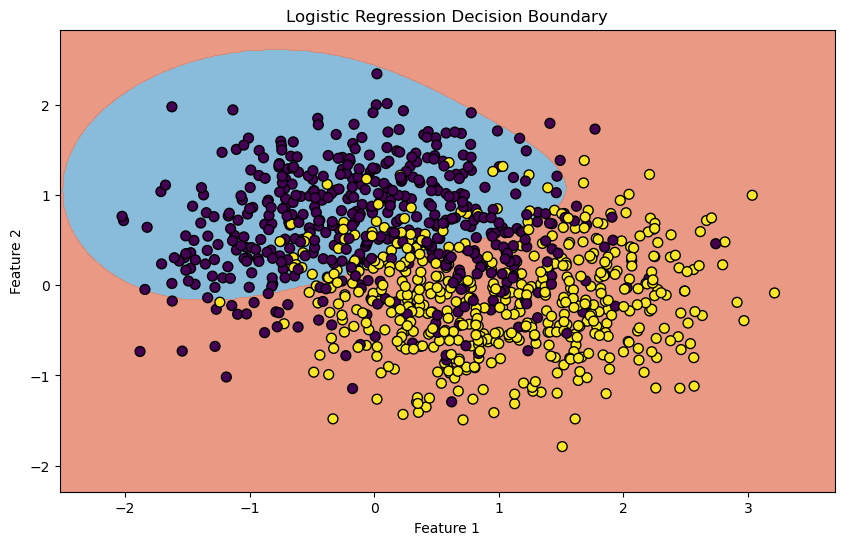

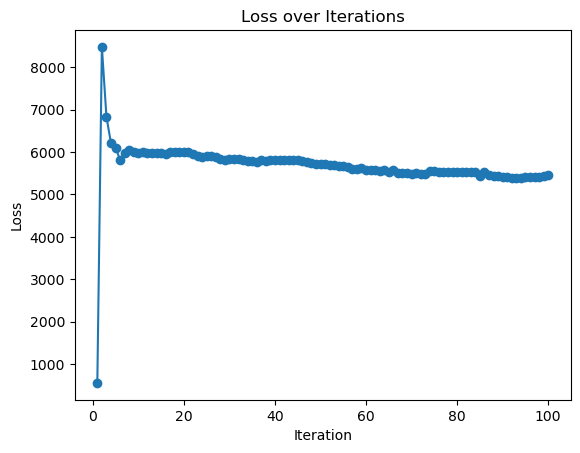

Test Accuracy: 77.00%
Hyperparameters: gamma=1, r=1, M=2, lambda=0.01
Number of zero coefficients: 0


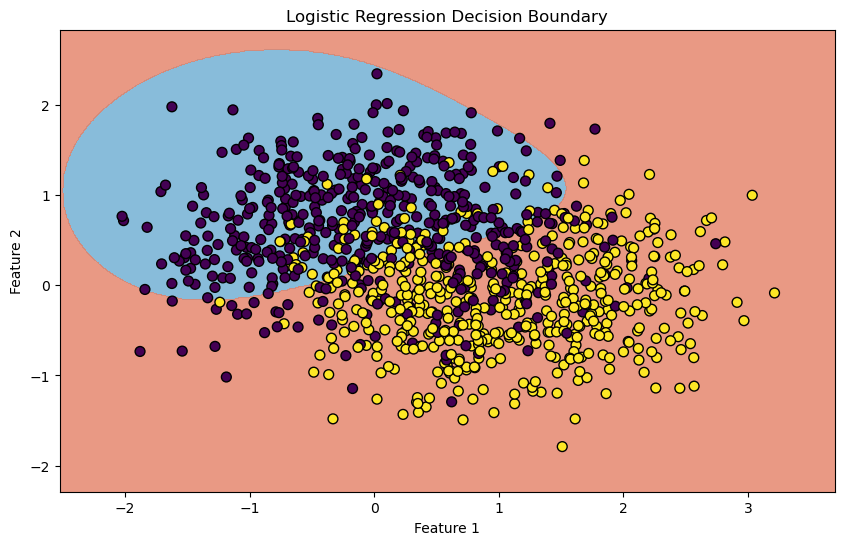

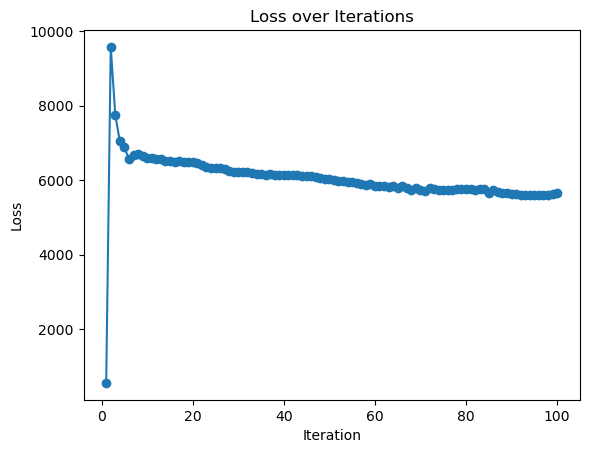

Test Accuracy: 77.00%
Hyperparameters: gamma=1, r=1, M=2, lambda=0.1
Number of zero coefficients: 0


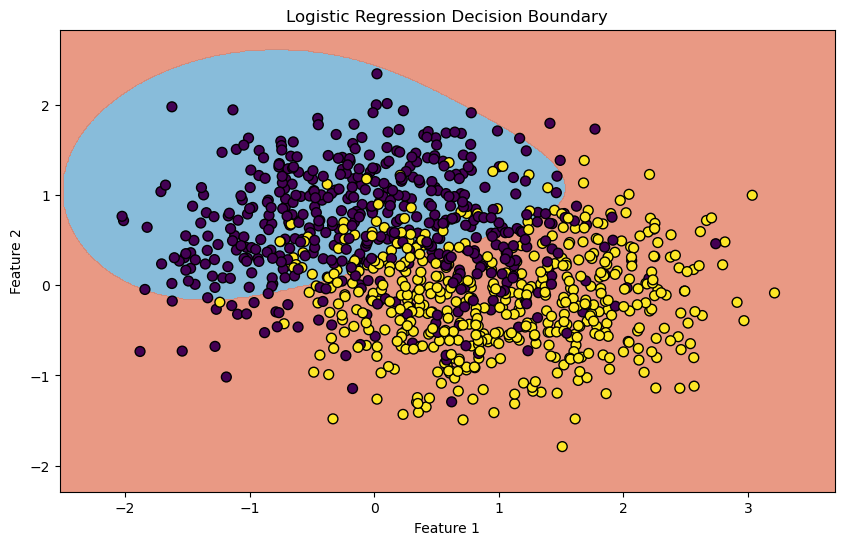

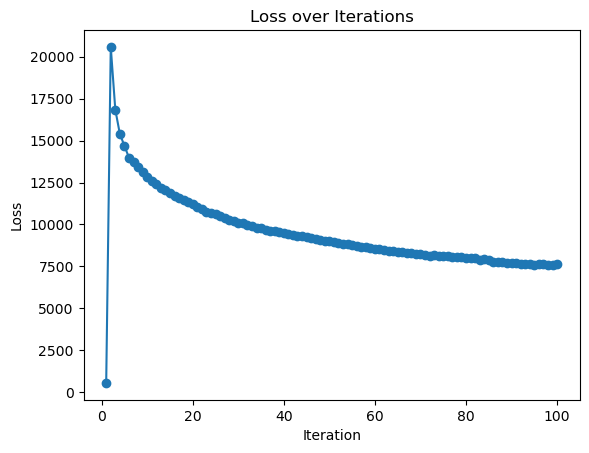

Test Accuracy: 77.00%
Hyperparameters: gamma=1, r=1, M=2, lambda=1
Number of zero coefficients: 0


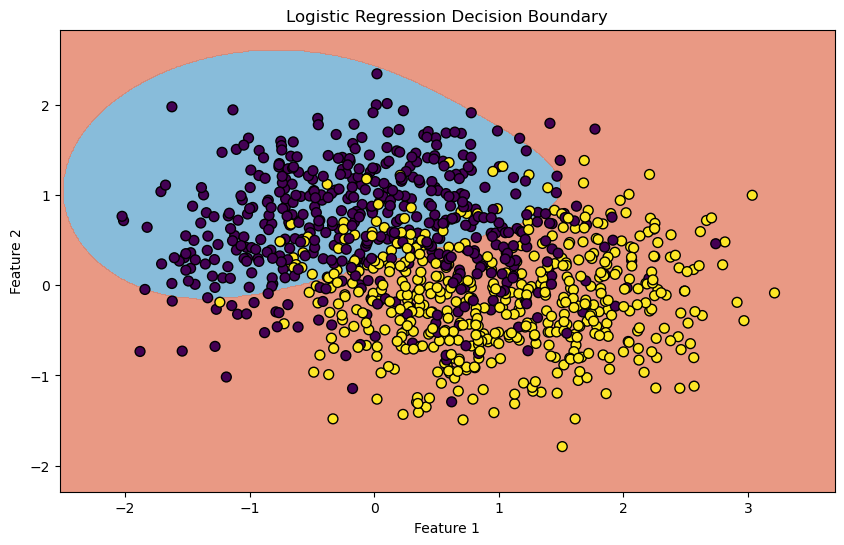

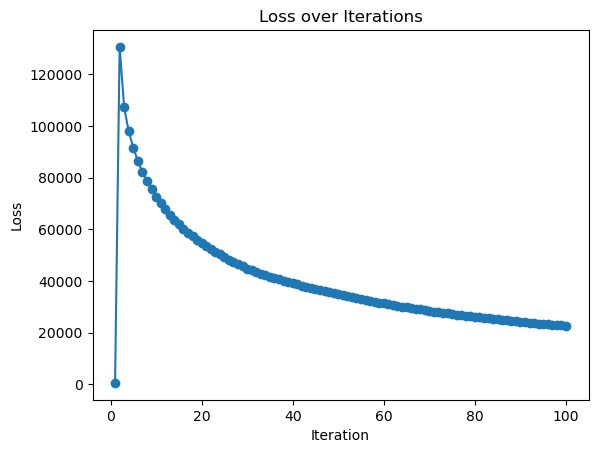

Test Accuracy: 76.00%
Hyperparameters: gamma=1, r=1, M=2, lambda=10
Number of zero coefficients: 0


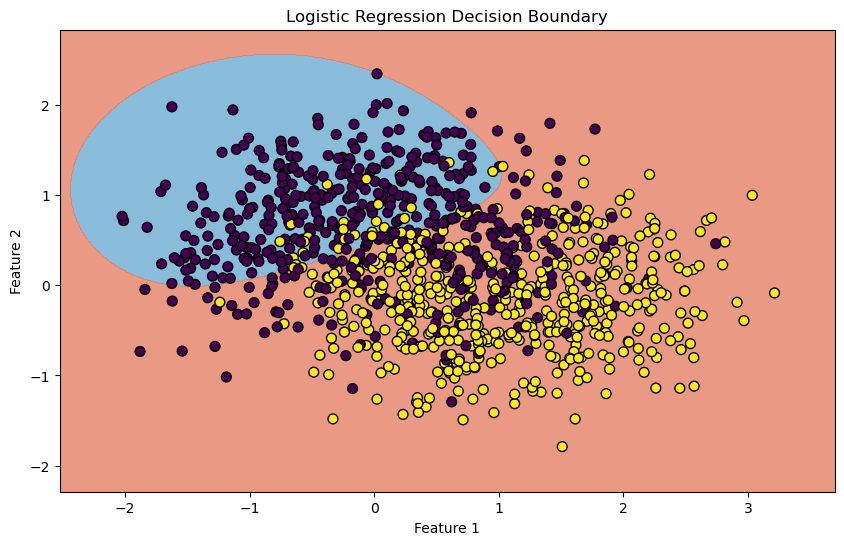

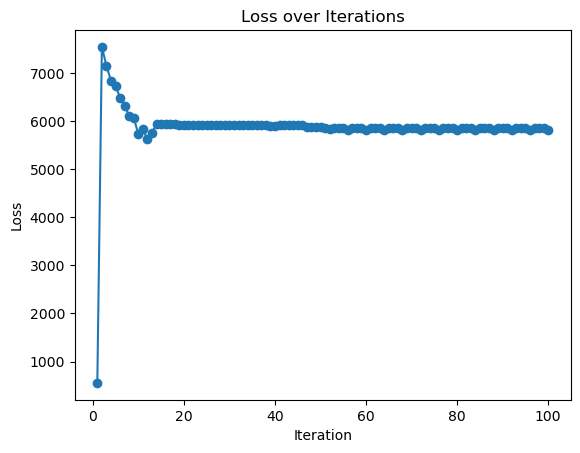

Test Accuracy: 77.00%
Hyperparameters: gamma=1, r=1, M=3, lambda=0.001
Number of zero coefficients: 0


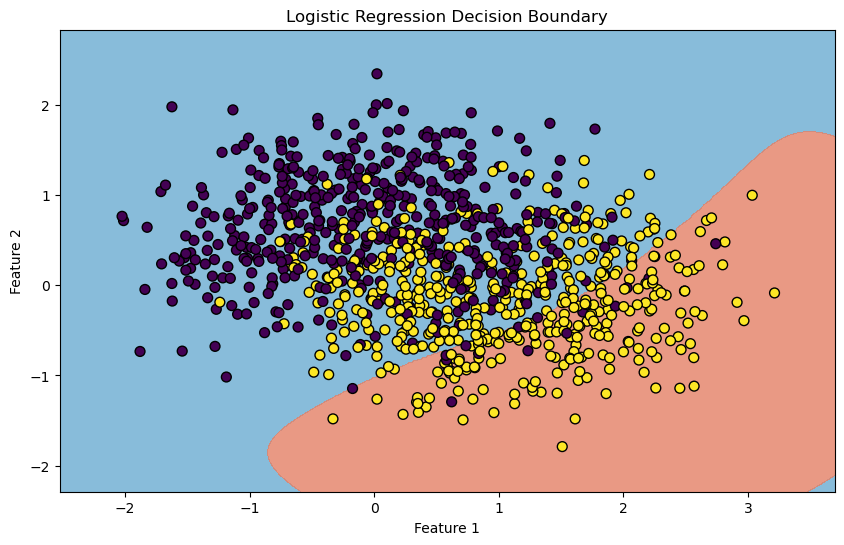

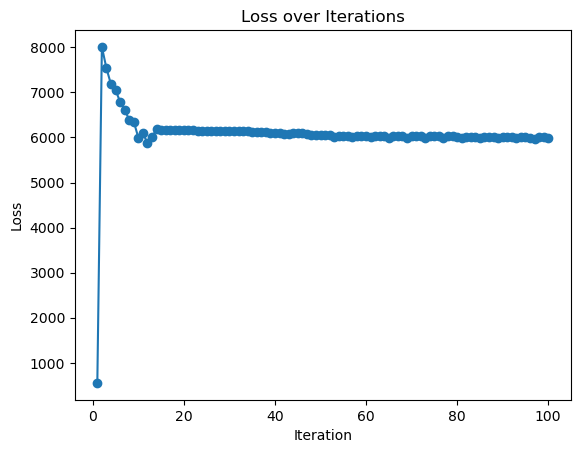

Test Accuracy: 77.00%
Hyperparameters: gamma=1, r=1, M=3, lambda=0.01
Number of zero coefficients: 0


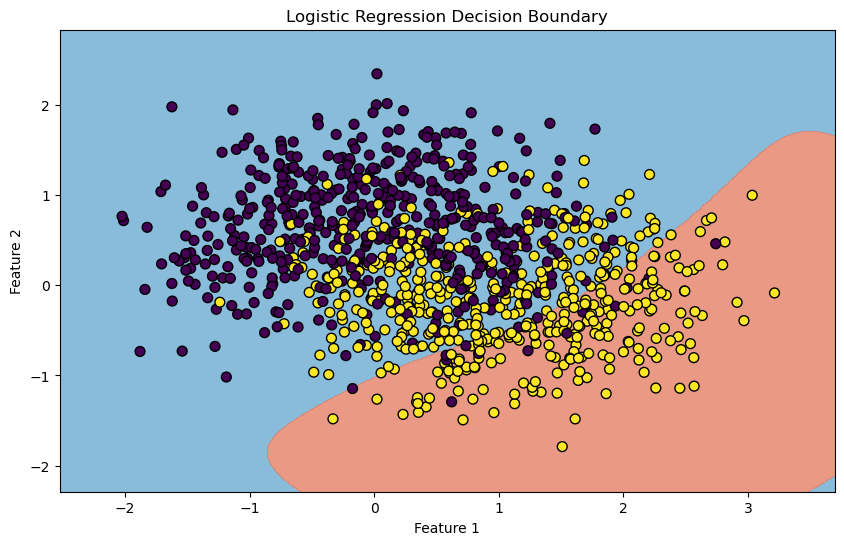

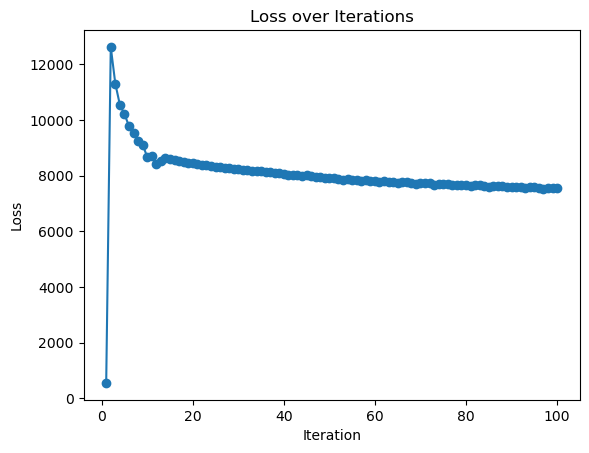

Test Accuracy: 77.00%
Hyperparameters: gamma=1, r=1, M=3, lambda=0.1
Number of zero coefficients: 0


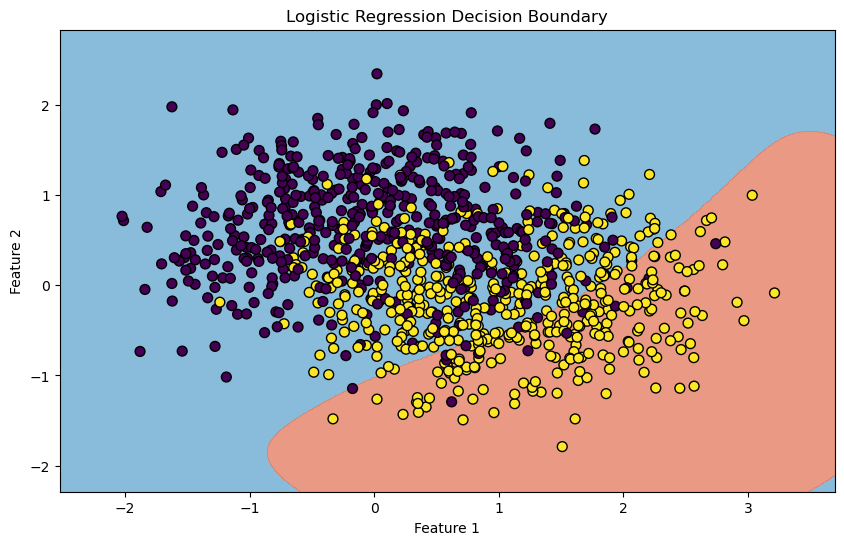

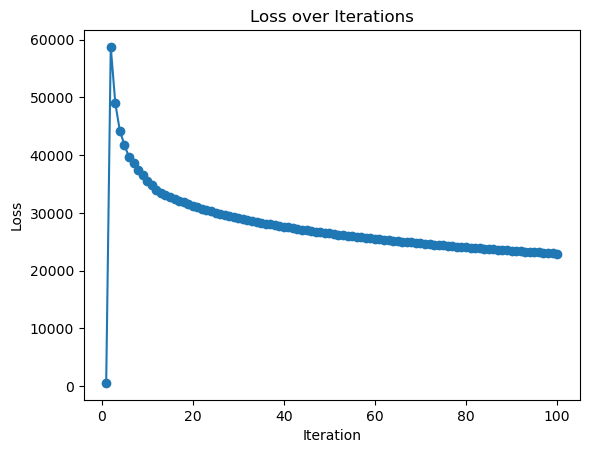

Test Accuracy: 77.00%
Hyperparameters: gamma=1, r=1, M=3, lambda=1
Number of zero coefficients: 0


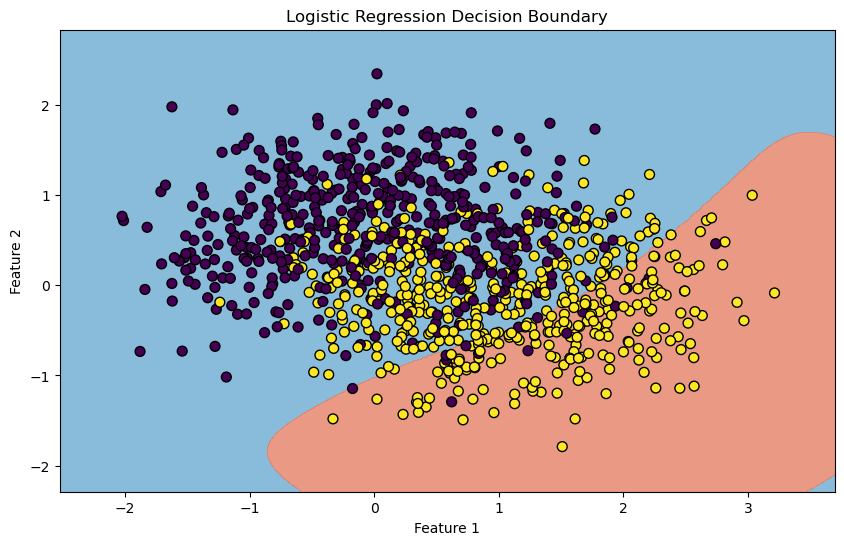

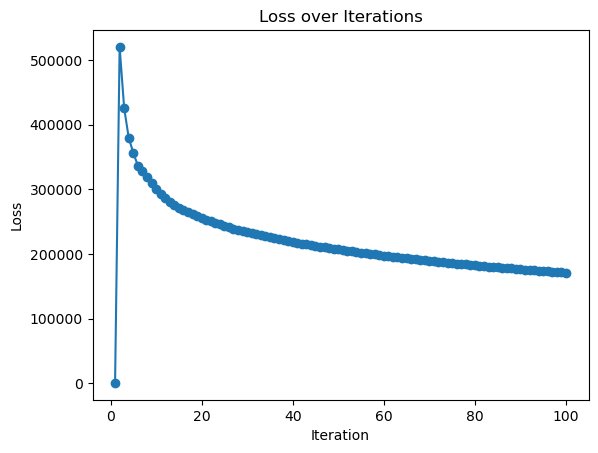

Test Accuracy: 77.00%
Hyperparameters: gamma=1, r=1, M=3, lambda=10
Number of zero coefficients: 0


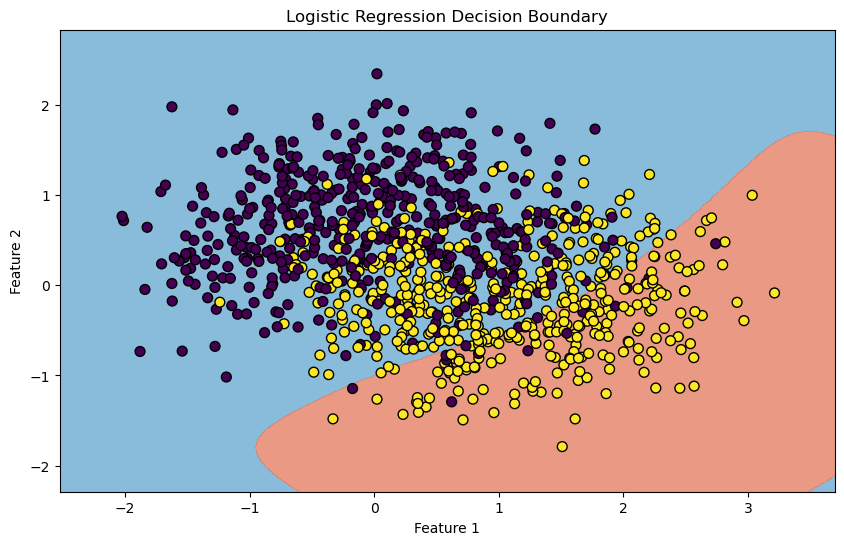

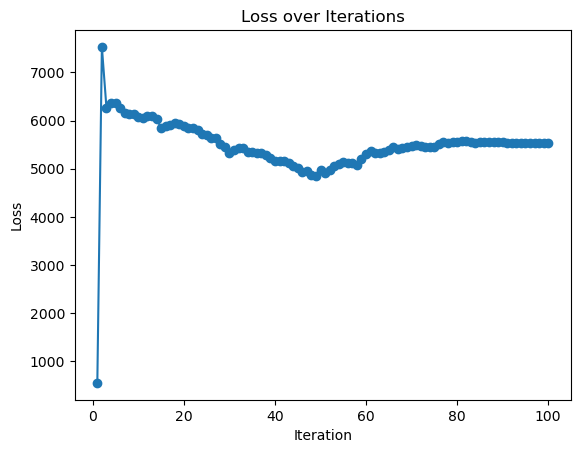

Test Accuracy: 75.00%
Hyperparameters: gamma=1, r=2, M=2, lambda=0.001
Number of zero coefficients: 0


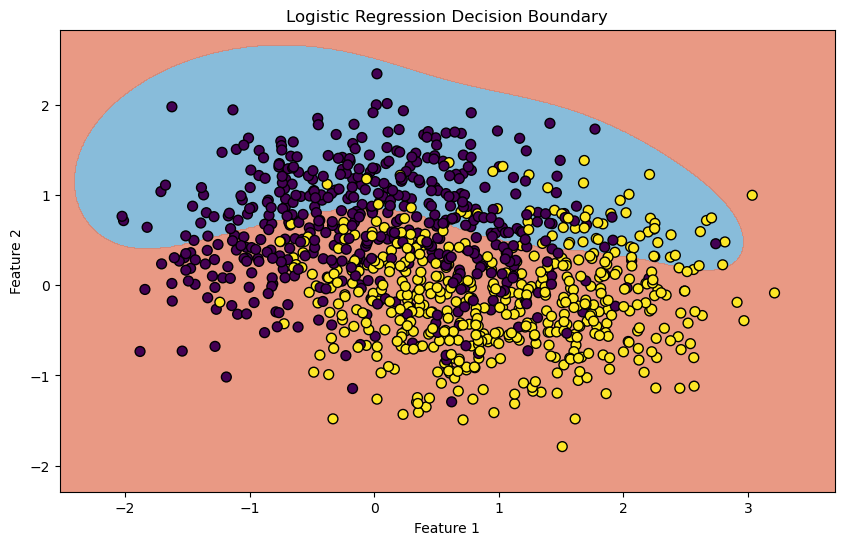

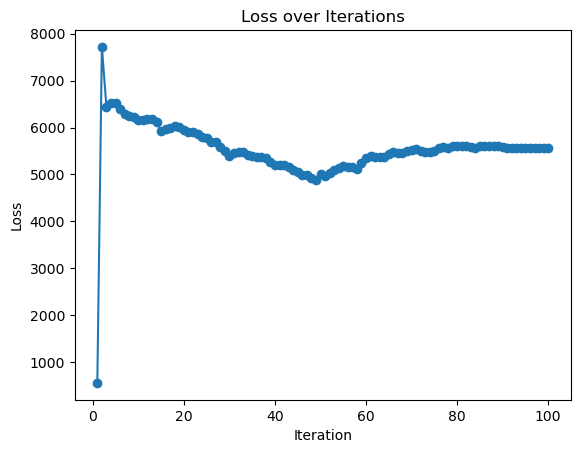

Test Accuracy: 75.00%
Hyperparameters: gamma=1, r=2, M=2, lambda=0.01
Number of zero coefficients: 0


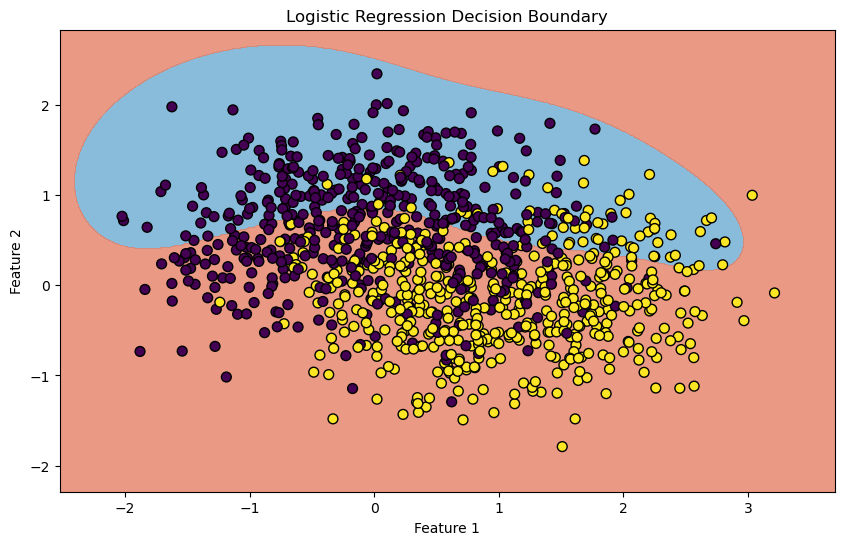

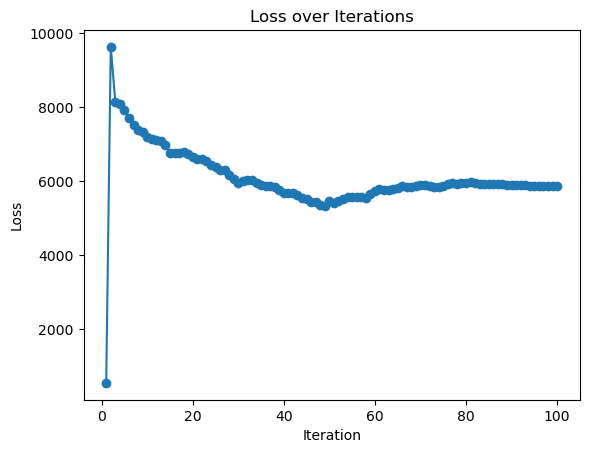

Test Accuracy: 75.00%
Hyperparameters: gamma=1, r=2, M=2, lambda=0.1
Number of zero coefficients: 0


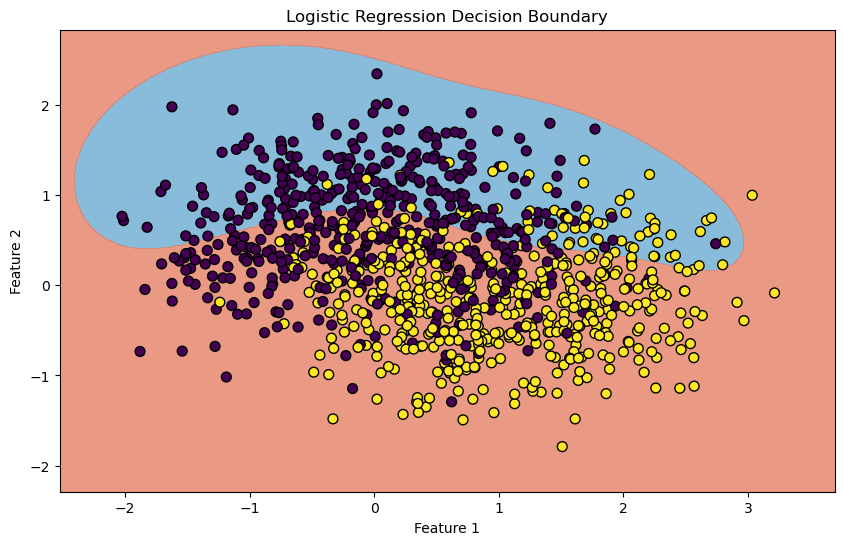

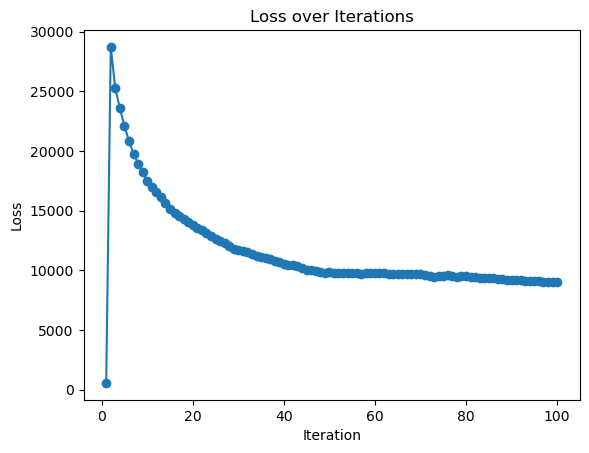

Test Accuracy: 75.00%
Hyperparameters: gamma=1, r=2, M=2, lambda=1
Number of zero coefficients: 0


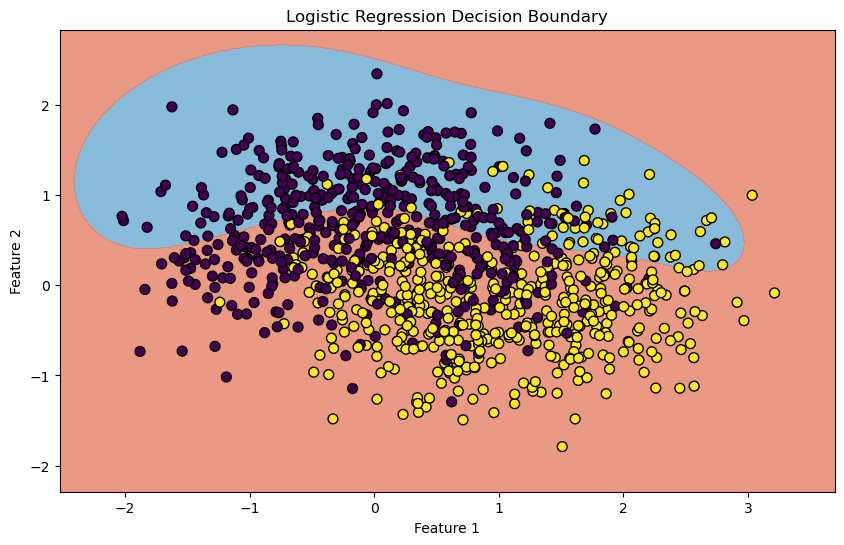

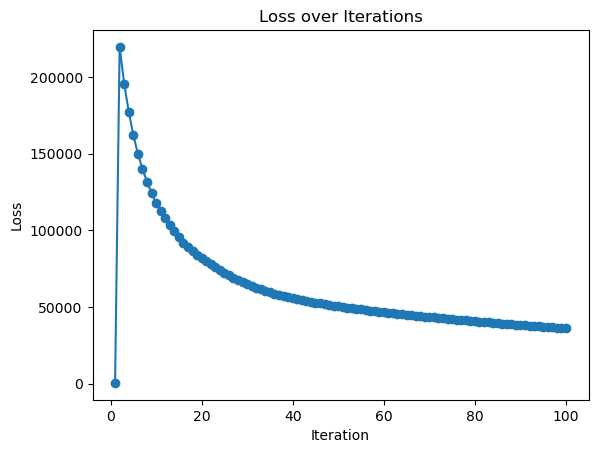

Test Accuracy: 73.00%
Hyperparameters: gamma=1, r=2, M=2, lambda=10
Number of zero coefficients: 0


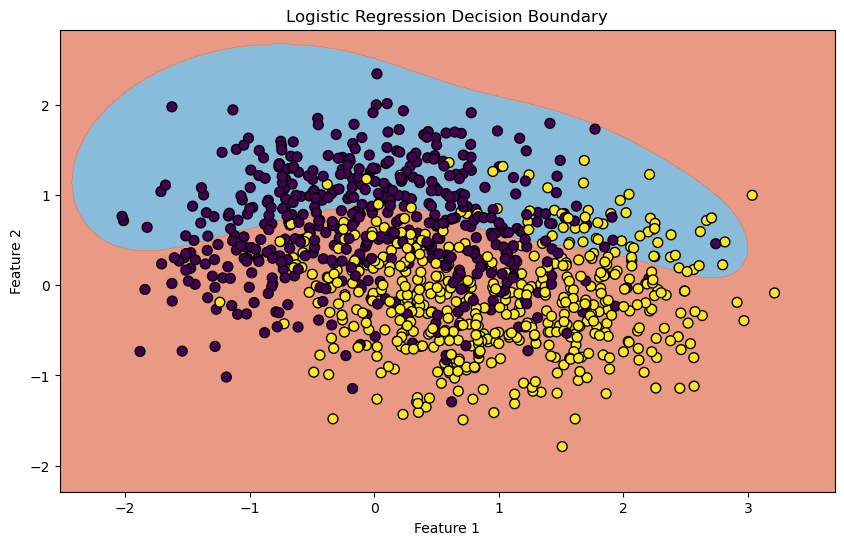

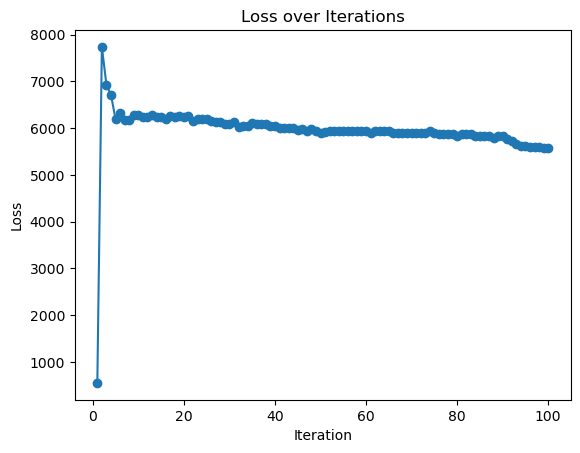

Test Accuracy: 76.00%
Hyperparameters: gamma=1, r=2, M=3, lambda=0.001
Number of zero coefficients: 0


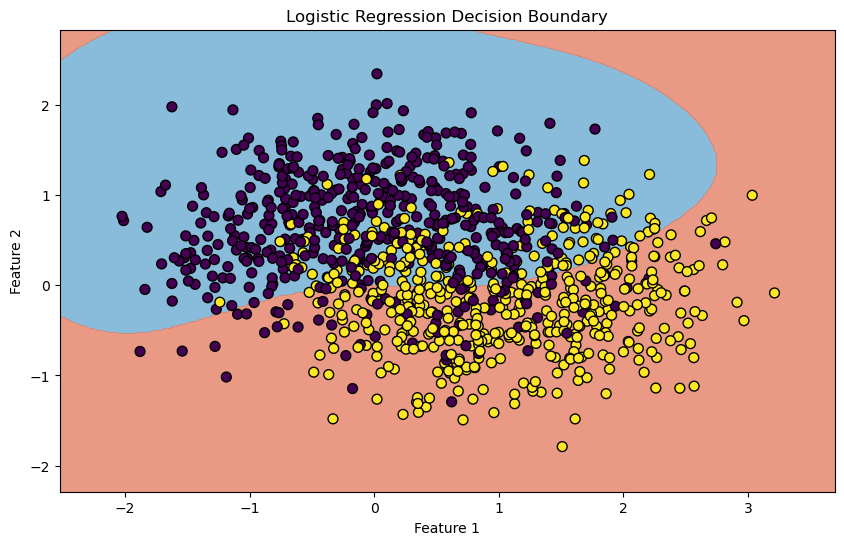

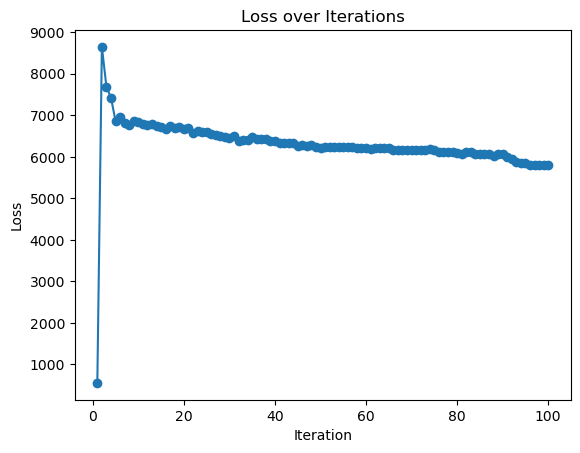

Test Accuracy: 76.00%
Hyperparameters: gamma=1, r=2, M=3, lambda=0.01
Number of zero coefficients: 0


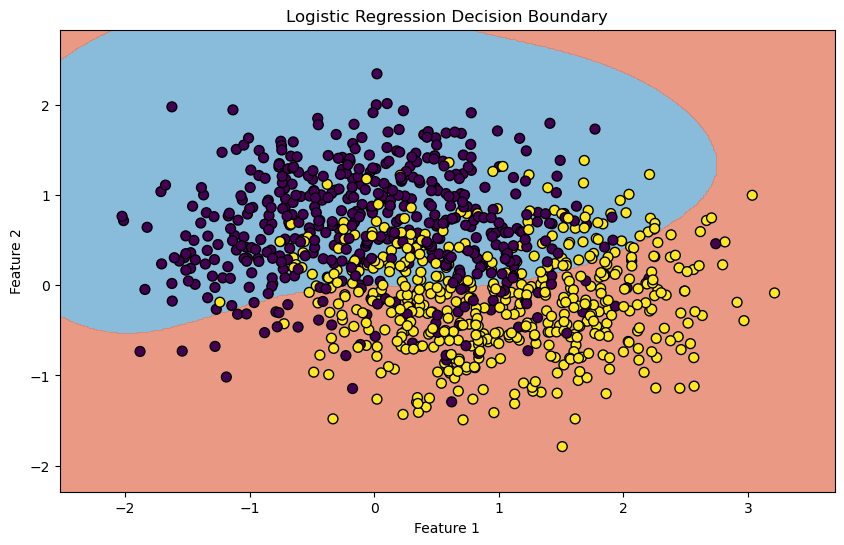

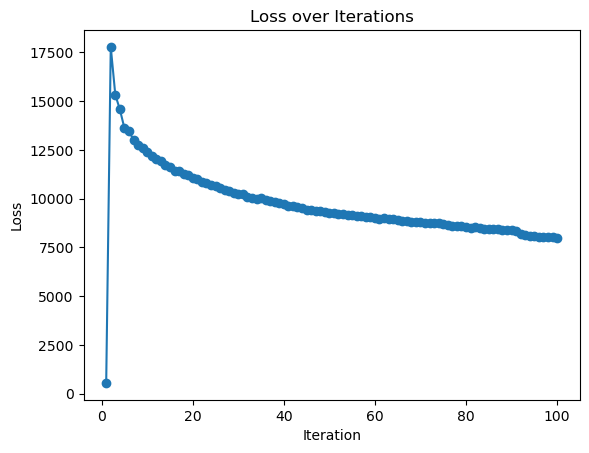

Test Accuracy: 76.00%
Hyperparameters: gamma=1, r=2, M=3, lambda=0.1
Number of zero coefficients: 0


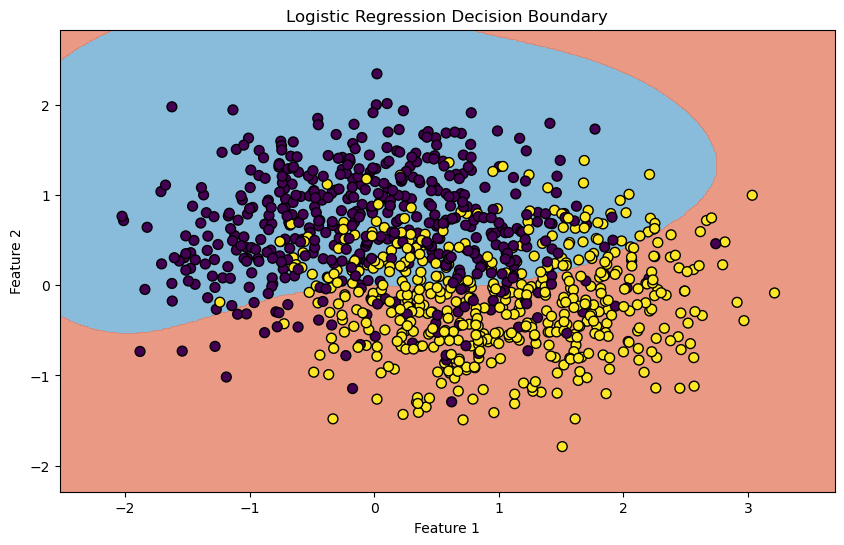

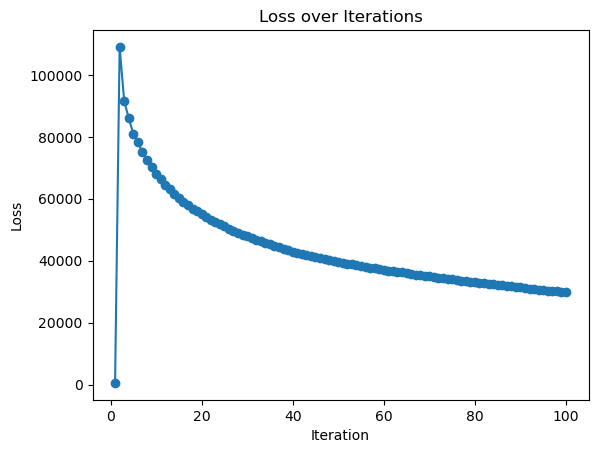

Test Accuracy: 76.00%
Hyperparameters: gamma=1, r=2, M=3, lambda=1
Number of zero coefficients: 0


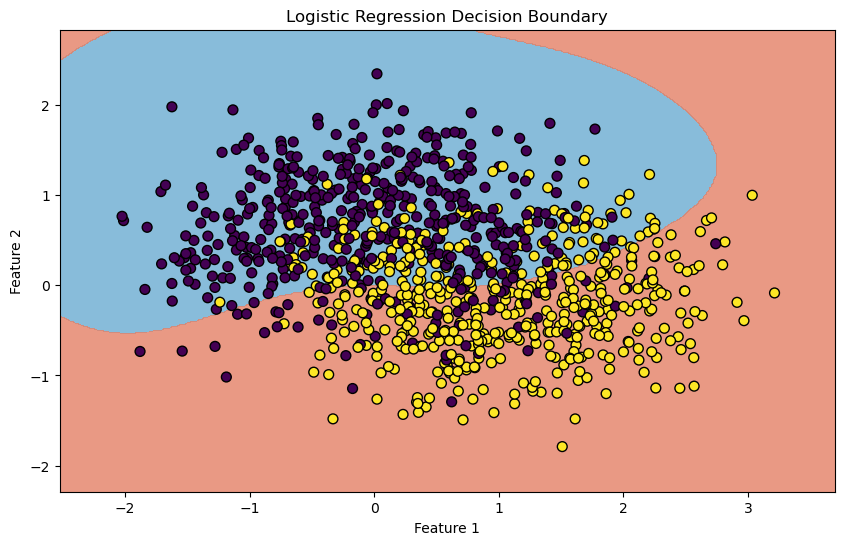

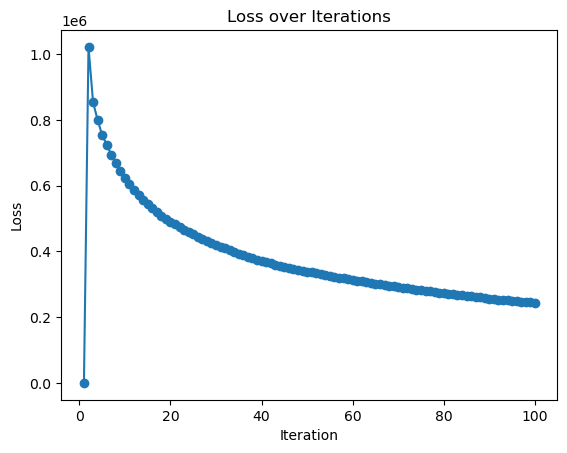

Test Accuracy: 76.00%
Hyperparameters: gamma=1, r=2, M=3, lambda=10
Number of zero coefficients: 0


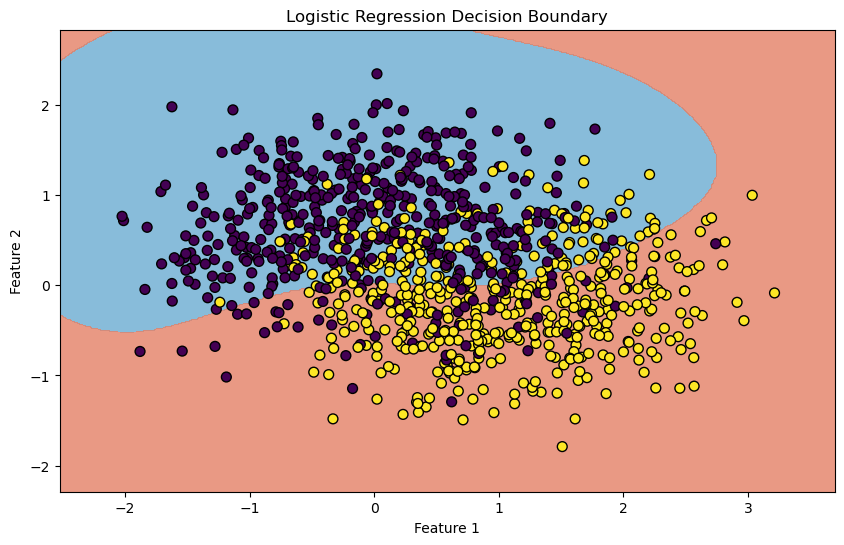

In [38]:
# Test using polynomial-kernel:
gammas = [0.01, 0.1, 1]
rs = [1, 2]
Ms = [2, 3]
lamdas = [0.001, 0.01, 0.1, 1, 10]

for gamma in gammas:
    for r in rs:
        for M in Ms:
            for lamda in lamdas:                
                x_train_kernel = polynomial_kernel(x_train, centroids, gamma, r, M)
                x_test_kernel = polynomial_kernel(x_test, centroids, gamma, r, M)

                w_ker = logistic_regression_L1_reg_train(x_train_kernel, y_train, lamda=lamda, nr_iters=100, C=1)

                accuracy = evaluate_model(x_test_kernel, y_test, w_ker)
                zero_coeff = np.sum(w_ker == 0)
                
                print(f"Hyperparameters: gamma={gamma}, r={r}, M={M}, lambda={lamda}")
                print(f"Number of zero coefficients: {zero_coeff}")
                
                draw_decision_boundary(X, y, w_ker, centroids, gamma, kernel=True)

- using the polynomial kernel I get:
  - Test Accuracy: 80.00%
  - Hyperparameters: gamma=0.1, r=1, M=3, lambda=10